In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
np.random.seed(2)
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

In [2]:
from keras.utils.np_utils import to_categorical
from keras.models import Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPool2D, Dropout
from keras.optimizers import Adam
from keras.preprocessing.image import ImageDataGenerator

In [7]:
#from keras.callbacks import EarlyS
from keras.callbacks import EarlyStopping

In [3]:
from PIL import Image, ImageChops, ImageEnhance
import os
import itertools
import cv2

In [4]:
import matplotlib.pyplot as plt
import numpy as np
import itertools
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# CNN Model for Error Level Analysis (ELA)

Loading authentic images...
Loading tampered images...

Data shapes:
Train: (2867, 64, 64, 3) (2867, 2)
Val: (717, 64, 64, 3) (717, 2)
Test: (399, 64, 64, 3) (399, 2)


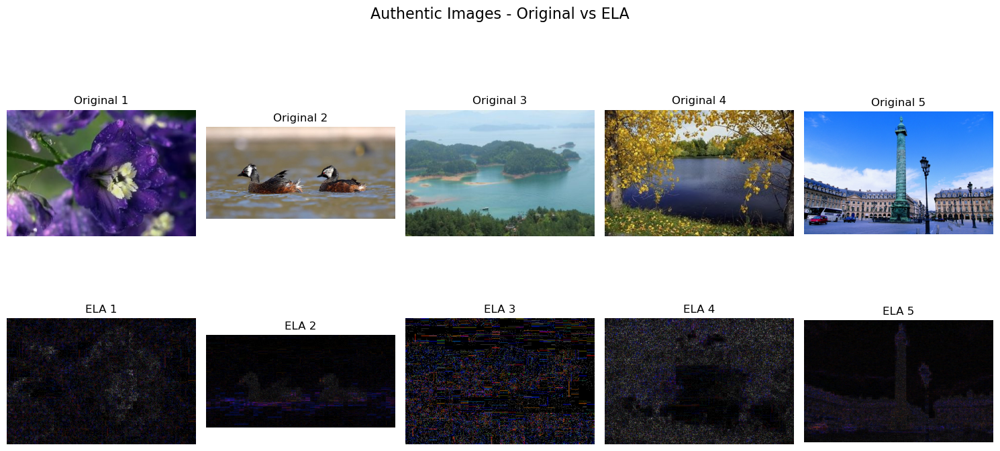

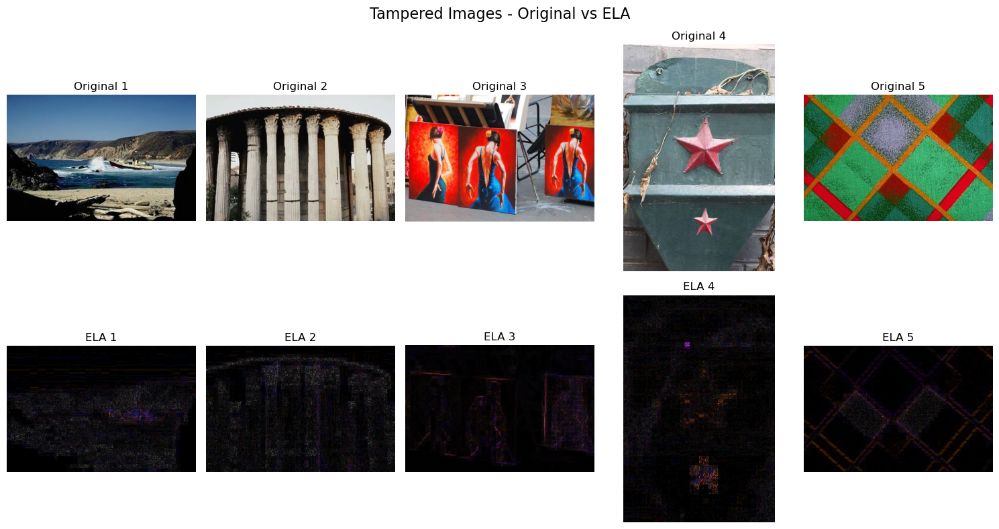

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 62, 62, 32)        896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 31, 31, 32)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 31, 31, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 14, 14, 64)       0         
 2D)                                                             
                                                                 
 dropout_1 (Dropout)         (None, 14, 14, 64)        0

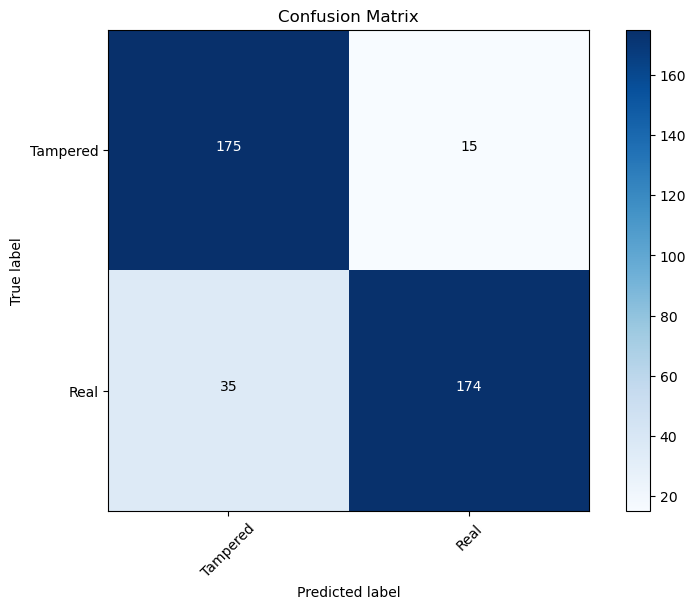

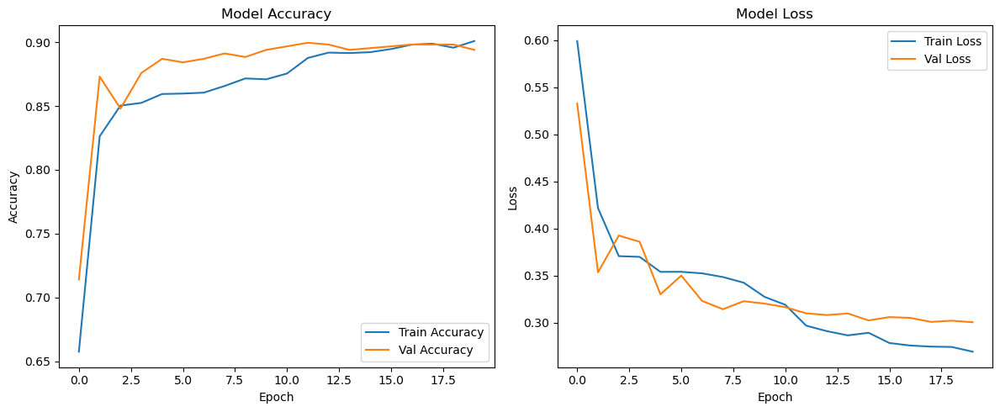


Sample predictions:
1/1 [==============================] - 0s 43ms/step
Image: Au_pla_30322.jpg
  Prediction: Real with 91.58% confidence
1/1 [==============================] - 0s 22ms/step
Image: Au_ani_10197.jpg
  Prediction: Tampered with 84.29% confidence
1/1 [==============================] - 0s 21ms/step
Image: Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg
  Prediction: Tampered with 85.31% confidence
1/1 [==============================] - 0s 21ms/step
Image: Tp_S_NND_S_N_arc00012_arc00012_01111.tif
  Prediction: Real with 60.82% confidence


In [5]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageChops, ImageEnhance
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Dropout, Flatten, Dense
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

# Enable mixed precision for faster training (uses FP16 where possible)
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# ELA processing function
def convert_to_ela_image(path, quality=90):
    temp_filename = 'temp.jpg'
    image = Image.open(path).convert('RGB')
    image.save(temp_filename, 'JPEG', quality=quality)
    temp_image = Image.open(temp_filename)
    
    ela_image = ImageChops.difference(image, temp_image)
    extrema = ela_image.getextrema()
    max_diff = max([ex[1] for ex in extrema]) or 1
    scale = 255.0 / max_diff
    ela_image = ImageEnhance.Brightness(ela_image).enhance(scale)
    
    return ela_image

def prepare_image_ela(image_path, target_size=(64, 64)):
    return np.array(convert_to_ela_image(image_path).resize(target_size)) / 255.0

# Define paths
au_path = "/kaggle/input/casia-dataset/CASIA2/Au"  # Authentic images
tp_path = "/kaggle/input/casia-dataset/CASIA2/Tp"  # Tampered images

# Initialize lists
X = []  # Images
Y = []  # Labels (0=Tampered, 1=Authentic)

print("Loading authentic images...")
for img_name in os.listdir(au_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(au_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_ela(img_path))
        Y.append(1)  # Label 1 = Authentic

print("Loading tampered images...")
for img_name in os.listdir(tp_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(tp_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_ela(img_path))
        Y.append(0)  # Label 0 = Tampered

# Convert to numpy arrays
X = np.array(X)
Y = to_categorical(Y, 2)  # One-hot encoding

# Split into Train, Validation, Test
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)

print("\nData shapes:")
print("Train:", X_train.shape, Y_train.shape)
print("Val:", X_val.shape, Y_val.shape)
print("Test:", X_test.shape, Y_test.shape)

# Visualization function
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Show sample images
def display_samples(image_paths, title):
    plt.figure(figsize=(15, 8))
    plt.suptitle(title, fontsize=16)
    
    for i, img_path in enumerate(image_paths[:5]):
        # Original Image
        plt.subplot(2, 5, i+1)
        orig_img = Image.open(img_path)
        plt.imshow(orig_img)
        plt.title(f"Original {i+1}")
        plt.axis('off')
        
        # ELA Processed Image
        plt.subplot(2, 5, i+6)
        ela_img = convert_to_ela_image(img_path)
        plt.imshow(ela_img)
        plt.title(f"ELA {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Authentic images
au_images = [os.path.join(au_path, f) for f in os.listdir(au_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(au_images, "Authentic Images - Original vs ELA")

# Tampered images
tp_images = [os.path.join(tp_path, f) for f in os.listdir(tp_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(tp_images, "Tampered Images - Original vs ELA")

# Simplified model architecture
def build_ela_model(input_shape=(64, 64, 3)):
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(64, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(128, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Flatten(),
        Dense(256, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax', dtype='float32')  # Ensure output is float32
    ])
    return model

# Build model
model_ela = build_ela_model()
model_ela.summary()

# Optimizer with learning rate schedule
optimizer = Adam(learning_rate=0.001)
model_ela.compile(optimizer=optimizer, 
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])

# Callbacks
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

# Train model
print("\nTraining model...")
history_ela = model_ela.fit(
    X_train, Y_train,
    batch_size=64,  # Increased batch size for faster processing
    epochs=20,
    validation_data=(X_val, Y_val),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

# Save model
model_ela.save('ela_model_optimized.h5')
print("Model saved as 'ela_model_optimized.h5'")

# Evaluate model
print("\nEvaluating model...")
test_loss, test_acc = model_ela.evaluate(X_test, Y_test, verbose=0)
print(f"\nTest Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Predictions
Y_pred = model_ela.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_true = np.argmax(Y_test, axis=1)

# Classification Report
print("\nClassification Report:")
print(classification_report(Y_true, Y_pred_classes, target_names=['Tampered', 'Real']))

# Confusion Matrix
confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
plt.figure(figsize=(8, 6))
plot_confusion_matrix(confusion_mtx, classes=['Tampered', 'Real'])
plt.title('Confusion Matrix')
plt.show()

# Plot training history
plt.figure(figsize=(12, 5))

# Accuracy plot
plt.subplot(1, 2, 1)
plt.plot(history_ela.history['accuracy'], label='Train Accuracy')
plt.plot(history_ela.history['val_accuracy'], label='Val Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()

# Loss plot
plt.subplot(1, 2, 2)
plt.plot(history_ela.history['loss'], label='Train Loss')
plt.plot(history_ela.history['val_loss'], label='Val Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()

plt.tight_layout()
plt.show()

# Sample predictions
def predict_image(model, image_path):
    image = prepare_image_ela(image_path)
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)
    class_idx = np.argmax(prediction)
    confidence = np.max(prediction)
    return "Real" if class_idx == 1 else "Tampered", confidence

# Test on sample images
print("\nSample predictions:")
for img_path in au_images[:2] + tp_images[:2]:
    prediction, confidence = predict_image(model_ela, img_path)
    print(f"Image: {os.path.basename(img_path)}")
    print(f"  Prediction: {prediction} with {confidence*100:.2f}% confidence")

# CNN Model for Noise Analysis

Loading authentic images...
Loading tampered images...

Data shapes:
Train: (2867, 64, 64, 3) (2867, 2)
Val: (717, 64, 64, 3) (717, 2)
Test: (399, 64, 64, 3) (399, 2)


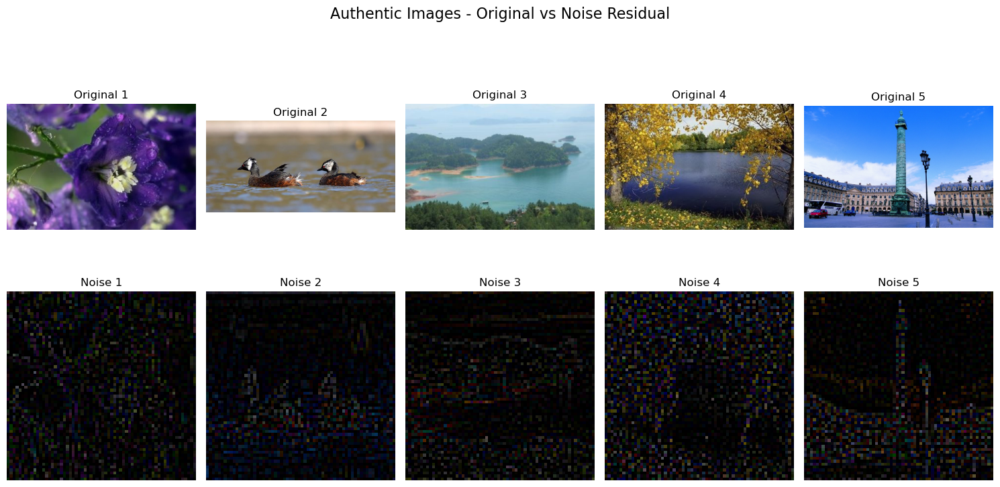

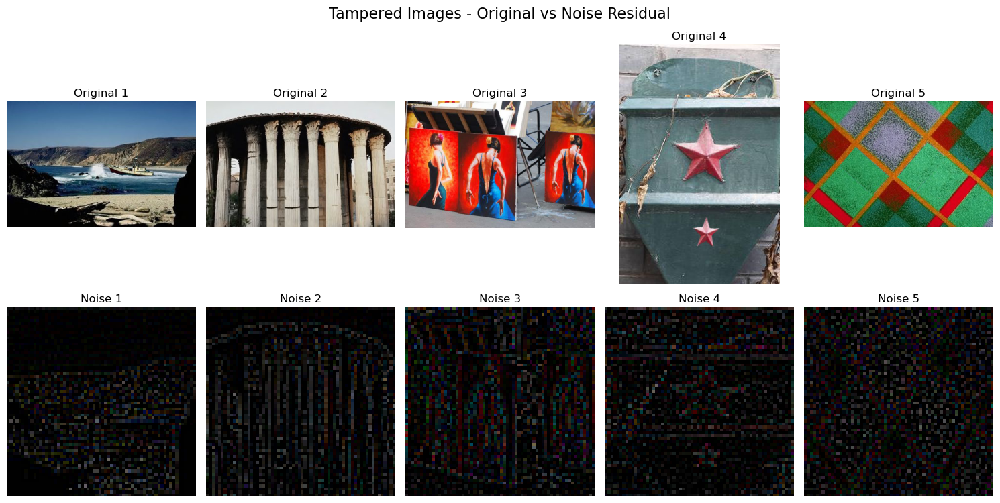

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_11 (Conv2D)          (None, 62, 62, 32)        896       
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 31, 31, 32)       0         
 g2D)                                                            
                                                                 
 dropout_14 (Dropout)        (None, 31, 31, 32)        0         
                                                                 
 conv2d_12 (Conv2D)          (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 14, 14, 64)       0         
 g2D)                                                            
                                                                 
 dropout_15 (Dropout)        (None, 14, 14, 64)       

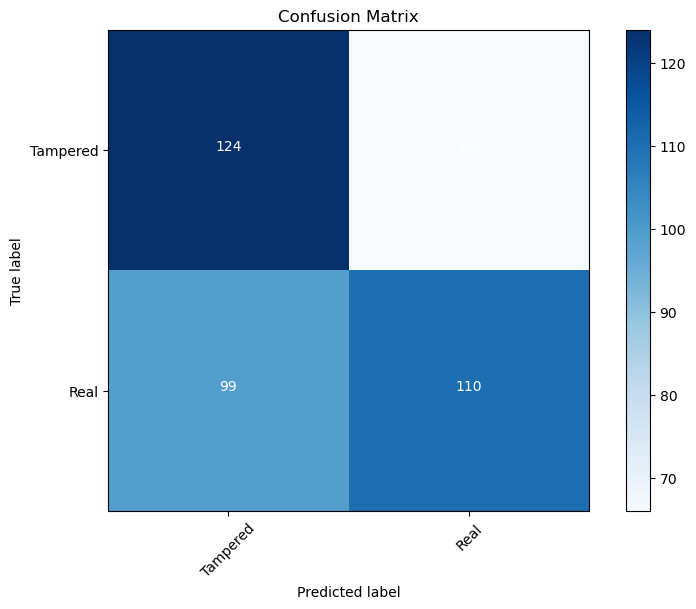

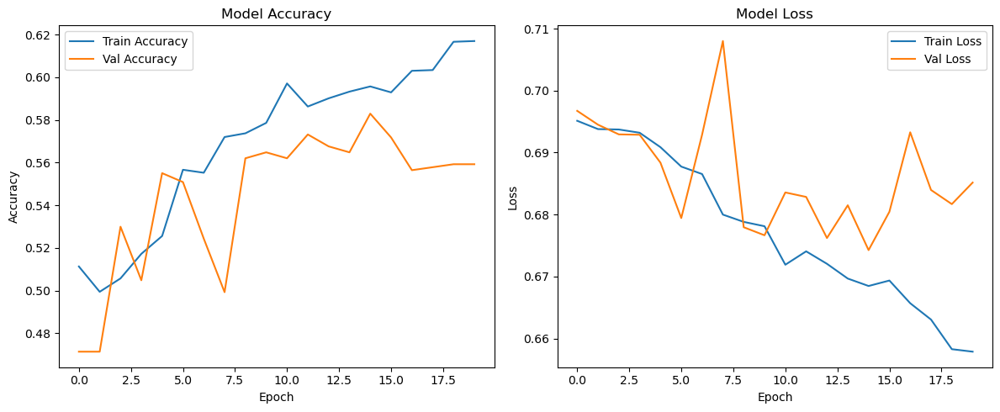


Sample predictions:
1/1 [==============================] - 0s 25ms/step
Image: Au_pla_30322.jpg
  Prediction: Tampered with 51.88% confidence
1/1 [==============================] - 0s 24ms/step
Image: Au_ani_10197.jpg
  Prediction: Real with 51.39% confidence
1/1 [==============================] - 0s 21ms/step
Image: Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg
  Prediction: Real with 55.87% confidence
1/1 [==============================] - 0s 21ms/step
Image: Tp_S_NND_S_N_arc00012_arc00012_01111.tif
  Prediction: Real with 59.65% confidence


In [8]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Dropout, Flatten, Dense
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

# Enable mixed precision for faster training
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Noise extraction function
def extract_noise(image_path, method='combined', enhanced=True):
    """
    Enhanced noise residual extraction from an image
    
    Args:
        image_path: Path to the image file
        method: 'nlm', 'gaussian', 'bilateral', 'combined', or 'wavelet'
        enhanced: Whether to apply additional enhancement techniques
    
    Returns:
        Noise residual as float32 array normalized to [0, 1]
    """
    image = cv2.imread(image_path)
    if image is None:
        return np.zeros((64, 64, 3), dtype=np.float32)
    
    # Convert to RGB and resize with better interpolation
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (64, 64), interpolation=cv2.INTER_LANCZOS4)
    
    # Convert to float32 for better precision
    image_float = image.astype(np.float32) / 255.0
    
    if method == 'nlm':
        # Optimized Non-local Means denoising
        denoised = cv2.fastNlMeansDenoisingColored(image, None, h=8, hColor=8, 
                                                  templateWindowSize=7, searchWindowSize=21)
        denoised = denoised.astype(np.float32) / 255.0
        noise = np.abs(image_float - denoised)
        
    elif method == 'gaussian':
        # Gaussian blur for noise extraction
        denoised = cv2.GaussianBlur(image_float, (5, 5), 1.0)
        noise = np.abs(image_float - denoised)
        
    elif method == 'bilateral':
        # Bilateral filter preserves edges better
        denoised = cv2.bilateralFilter(image, 9, 75, 75).astype(np.float32) / 255.0
        noise = np.abs(image_float - denoised)
        
    elif method == 'wavelet':
        # Wavelet-based noise extraction (requires pywt)
        try:
            import pywt
            noise_channels = []
            for channel in range(3):
                coeffs = pywt.dwt2(image_float[:, :, channel], 'db4')
                # Zero out the approximation coefficients to keep only details
                coeffs_thresh = (np.zeros_like(coeffs[0]), coeffs[1], coeffs[2], coeffs[3])
                noise_channel = pywt.idwt2(coeffs_thresh, 'db4')
                noise_channels.append(np.abs(noise_channel))
            noise = np.stack(noise_channels, axis=2)
        except ImportError:
            # Fallback to Gaussian if pywt not available
            denoised = cv2.GaussianBlur(image_float, (5, 5), 1.0)
            noise = np.abs(image_float - denoised)
            
    elif method == 'combined':
        # Combine multiple denoising methods for robust noise extraction
        # Non-local means
        denoised_nlm = cv2.fastNlMeansDenoisingColored(image, None, h=8, hColor=8, 
                                                      templateWindowSize=7, searchWindowSize=21)
        denoised_nlm = denoised_nlm.astype(np.float32) / 255.0
        
        # Bilateral filter
        denoised_bilateral = cv2.bilateralFilter(image, 9, 75, 75).astype(np.float32) / 255.0
        
        # Gaussian blur
        denoised_gaussian = cv2.GaussianBlur(image_float, (5, 5), 1.0)
        
        # Average the denoised versions
        denoised_avg = (denoised_nlm + denoised_bilateral + denoised_gaussian) / 3.0
        noise = np.abs(image_float - denoised_avg)
    
    else:
        raise ValueError(f"Unknown method: {method}")
    
    if enhanced:
        # Apply enhancement techniques
        # 1. Contrast enhancement using CLAHE
        noise_enhanced = np.zeros_like(noise)
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(4, 4))
        
        for channel in range(3):
            # Convert to uint8 for CLAHE
            noise_uint8 = (noise[:, :, channel] * 255).astype(np.uint8)
            noise_enhanced[:, :, channel] = clahe.apply(noise_uint8).astype(np.float32) / 255.0
        
        # 2. Gamma correction to enhance weak signals
        gamma = 0.7
        noise_enhanced = np.power(noise_enhanced, gamma)
        
        # 3. High-pass filter to emphasize high-frequency noise
        kernel = np.array([[-1, -1, -1],
                          [-1,  9, -1],
                          [-1, -1, -1]]) / 9.0
        
        noise_filtered = np.zeros_like(noise_enhanced)
        for channel in range(3):
            filtered = cv2.filter2D(noise_enhanced[:, :, channel], -1, kernel)
            noise_filtered[:, :, channel] = np.clip(filtered, 0, 1)
        
        noise = noise_filtered
    
    # Ensure values are in [0, 1] range
    noise = np.clip(noise, 0, 1)
    
    return noise.astype(np.float32)

def prepare_image_noise(image_path):
    """Prepare noise image for model input"""
    return extract_noise(image_path)

# Define paths
au_path = "/kaggle/input/casia-dataset/CASIA2/Au"  # Authentic images
tp_path = "/kaggle/input/casia-dataset/CASIA2/Tp"  # Tampered images

# Initialize lists
X = []  # Images
Y = []  # Labels (0=Tampered, 1=Authentic)

print("Loading authentic images...")
for img_name in os.listdir(au_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(au_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_noise(img_path))
        Y.append(1)  # Label 1 = Authentic

print("Loading tampered images...")
for img_name in os.listdir(tp_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(tp_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_noise(img_path))
        Y.append(0)  # Label 0 = Tampered

# Convert to numpy arrays
X = np.array(X)
Y = to_categorical(Y, 2)  # One-hot encoding

# Split into Train, Validation, Test
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)

print("\nData shapes:")
print("Train:", X_train.shape, Y_train.shape)
print("Val:", X_val.shape, Y_val.shape)
print("Test:", X_test.shape, Y_test.shape)

# Visualization function
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Show sample images
def display_samples(image_paths, title):
    plt.figure(figsize=(15, 8))
    plt.suptitle(title, fontsize=16)
    
    for i, img_path in enumerate(image_paths[:5]):
        # Original Image
        plt.subplot(2, 5, i+1)
        orig_img = Image.open(img_path)
        plt.imshow(orig_img)
        plt.title(f"Original {i+1}")
        plt.axis('off')
        
        # Noise Residual Image
        plt.subplot(2, 5, i+6)
        noise_img = extract_noise(img_path)
        # For visualization, we need to scale noise to 0-255 range
        noise_vis = (noise_img * 255).astype(np.uint8)
        plt.imshow(noise_vis)
        plt.title(f"Noise {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Authentic images
au_images = [os.path.join(au_path, f) for f in os.listdir(au_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(au_images, "Authentic Images - Original vs Noise Residual")

# Tampered images
tp_images = [os.path.join(tp_path, f) for f in os.listdir(tp_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(tp_images, "Tampered Images - Original vs Noise Residual")

# Model architecture optimized for noise analysis
def build_noise_model(input_shape=(64, 64, 3)):
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(64, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(128, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(256, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Flatten(),
        Dense(512, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax', dtype='float32')
    ])
    return model

# Build model
model_noise = build_noise_model()
model_noise.summary()

# Optimizer with learning rate schedule
optimizer = Adam(learning_rate=0.001)
model_noise.compile(optimizer=optimizer, 
                    loss='categorical_crossentropy', 
                    metrics=['accuracy'])

# Callbacks
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

# Train model
print("\nTraining model...")
history_noise = model_noise.fit(
    X_train, Y_train,
    batch_size=64,
    epochs=20,
    validation_data=(X_val, Y_val),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

# Save model
model_noise.save('noise_model.h5')
print("Model saved as 'noise_model.h5'")

# Evaluate model
print("\nEvaluating model...")
test_loss, test_acc = model_noise.evaluate(X_test, Y_test, verbose=0)
print(f"\nTest Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Predictions
Y_pred = model_noise.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_true = np.argmax(Y_test, axis=1)

# Classification Report
print("\nClassification Report:")
print(classification_report(Y_true, Y_pred_classes, target_names=['Tampered', 'Real']))

# Confusion Matrix
confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
plt.figure(figsize=(8, 6))
plot_confusion_matrix(confusion_mtx, classes=['Tampered', 'Real'])
plt.title('Confusion Matrix')
plt.show()

# Plot training history
plt.figure(figsize=(12, 5))

# Accuracy plot
plt.subplot(1, 2, 1)
plt.plot(history_noise.history['accuracy'], label='Train Accuracy')
plt.plot(history_noise.history['val_accuracy'], label='Val Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()

# Loss plot
plt.subplot(1, 2, 2)
plt.plot(history_noise.history['loss'], label='Train Loss')
plt.plot(history_noise.history['val_loss'], label='Val Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()

plt.tight_layout()
plt.show()

# Sample predictions
def predict_image(model, image_path):
    image = prepare_image_noise(image_path)
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)
    class_idx = np.argmax(prediction)
    confidence = np.max(prediction)
    return "Real" if class_idx == 1 else "Tampered", confidence

# Test on sample images
print("\nSample predictions:")
for img_path in au_images[:2] + tp_images[:2]:
    prediction, confidence = predict_image(model_noise, img_path)
    print(f"Image: {os.path.basename(img_path)}")
    print(f"  Prediction: {prediction} with {confidence*100:.2f}% confidence")

# CNN Model for Edge Detection

Loading authentic images...
Loading tampered images...

Data shapes:
Train: (2867, 64, 64, 3) (2867, 2)
Val: (717, 64, 64, 3) (717, 2)
Test: (399, 64, 64, 3) (399, 2)


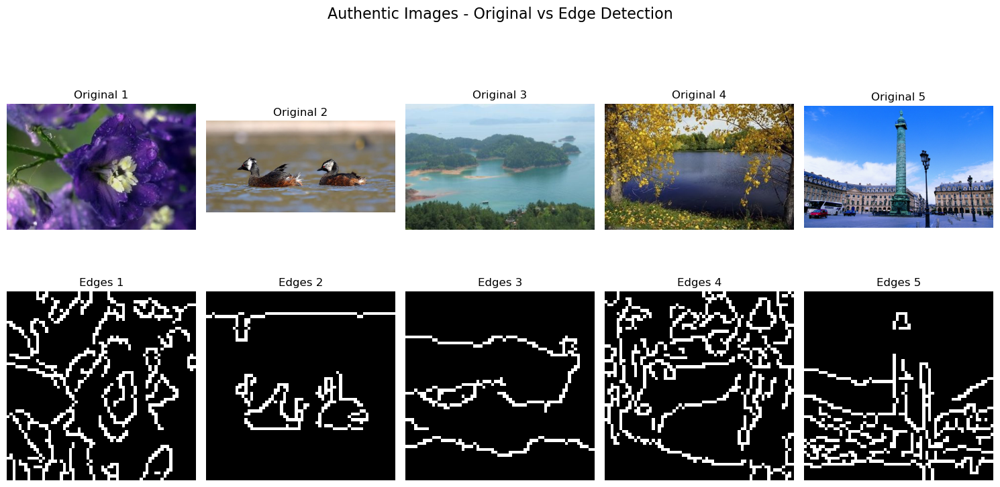

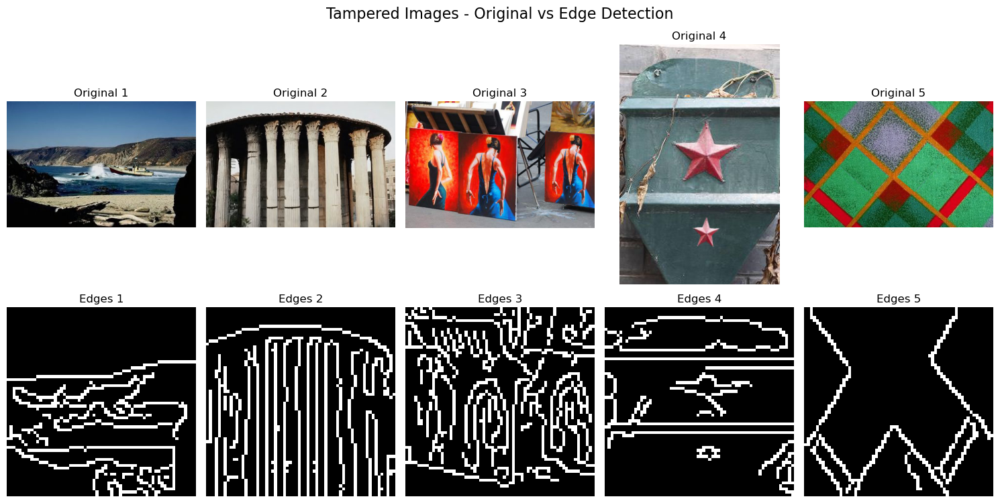

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_115 (Conv2D)         (None, 62, 62, 32)        896       
                                                                 
 conv2d_116 (Conv2D)         (None, 60, 60, 32)        9248      
                                                                 
 max_pooling2d_47 (MaxPoolin  (None, 30, 30, 32)       0         
 g2D)                                                            
                                                                 
 dropout_81 (Dropout)        (None, 30, 30, 32)        0         
                                                                 
 conv2d_117 (Conv2D)         (None, 28, 28, 64)        18496     
                                                                 
 conv2d_118 (Conv2D)         (None, 26, 26, 64)        36928     
                                                     

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


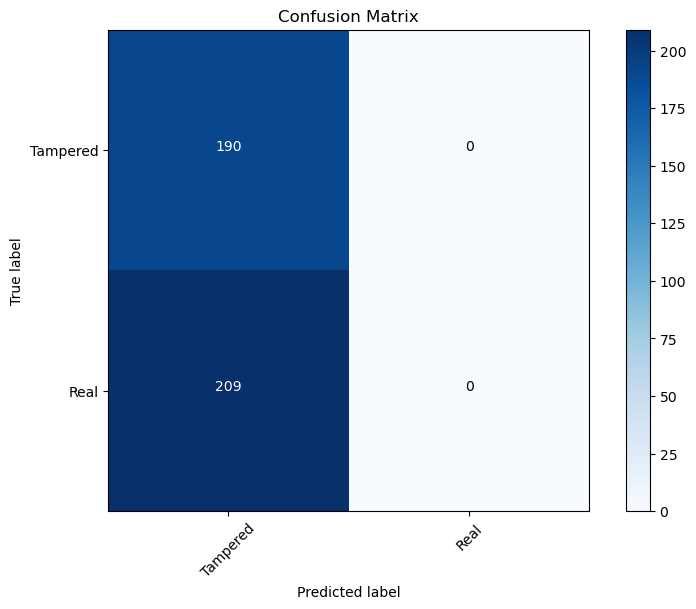

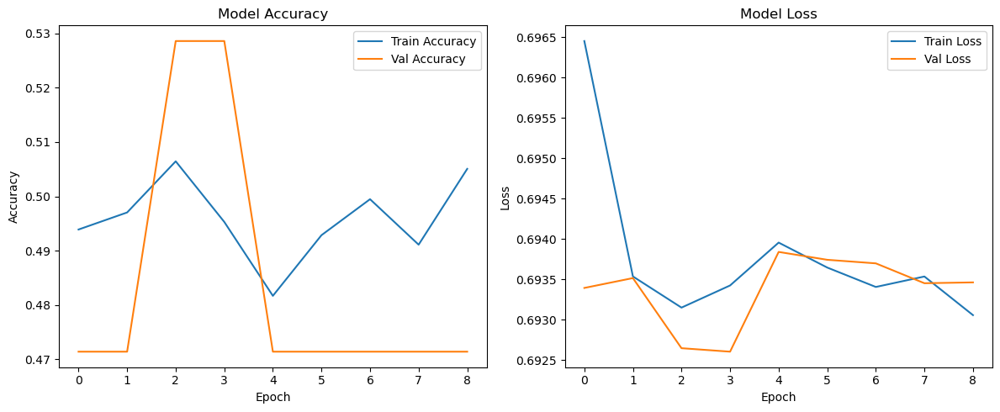


Sample predictions:
1/1 [==============================] - 0s 26ms/step
Image: Au_pla_30322.jpg
  Prediction: Tampered with 50.52% confidence
1/1 [==============================] - 0s 21ms/step
Image: Au_ani_10197.jpg
  Prediction: Tampered with 50.52% confidence
1/1 [==============================] - 0s 20ms/step
Image: Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg
  Prediction: Tampered with 50.52% confidence
1/1 [==============================] - 0s 21ms/step
Image: Tp_S_NND_S_N_arc00012_arc00012_01111.tif
  Prediction: Tampered with 50.52% confidence


In [21]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Dropout, Flatten, Dense
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

# Enable mixed precision for faster training
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Edge detection function
def extract_edges(image_path, target_size=(64, 64)):
    """Extract edges from an image using Canny edge detection"""
    # Read image in grayscale
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if image is None:
        return np.zeros((*target_size, 3))  # Fallback if image fails to load
    
    # Resize image
    image = cv2.resize(image, target_size)
    
    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(image, (5, 5), 0)
    
    # Apply Canny edge detection
    edges = cv2.Canny(blurred, 50, 150)
    
    # Convert to 3-channel image for CNN compatibility
    edges_rgb = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)
    return edges_rgb.astype(np.float32) / 255.0

def prepare_image_edges(image_path):
    """Prepare edge image for model input"""
    return extract_edges(image_path)

# Define paths
au_path = "/kaggle/input/casia-dataset/CASIA2/Au"  # Authentic images
tp_path = "/kaggle/input/casia-dataset/CASIA2/Tp"  # Tampered images

# Initialize lists
X = []  # Images
Y = []  # Labels (0=Tampered, 1=Authentic)

print("Loading authentic images...")
for img_name in os.listdir(au_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(au_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_edges(img_path))
        Y.append(1)  # Label 1 = Authentic

print("Loading tampered images...")
for img_name in os.listdir(tp_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(tp_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_edges(img_path))
        Y.append(0)  # Label 0 = Tampered

# Convert to numpy arrays
X = np.array(X)
Y = to_categorical(Y, 2)  # One-hot encoding

# Split into Train, Validation, Test
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)

print("\nData shapes:")
print("Train:", X_train.shape, Y_train.shape)
print("Val:", X_val.shape, Y_val.shape)
print("Test:", X_test.shape, Y_test.shape)

# Visualization function
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Show sample images
def display_samples(image_paths, title):
    plt.figure(figsize=(15, 8))
    plt.suptitle(title, fontsize=16)
    
    for i, img_path in enumerate(image_paths[:5]):
        # Original Image
        plt.subplot(2, 5, i+1)
        orig_img = Image.open(img_path)
        plt.imshow(orig_img)
        plt.title(f"Original {i+1}")
        plt.axis('off')
        
        # Edge Detection Image
        plt.subplot(2, 5, i+6)
        edge_img = extract_edges(img_path)
        # For visualization, we need to scale edges to 0-255 range
        edge_vis = (edge_img * 255).astype(np.uint8)
        plt.imshow(edge_vis)
        plt.title(f"Edges {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Authentic images
au_images = [os.path.join(au_path, f) for f in os.listdir(au_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(au_images, "Authentic Images - Original vs Edge Detection")

# Tampered images
tp_images = [os.path.join(tp_path, f) for f in os.listdir(tp_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(tp_images, "Tampered Images - Original vs Edge Detection")

# Model architecture optimized for edge detection
def build_edge_model(input_shape=(64, 64, 3)):
    model = Sequential([
        # First convolution block
        Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        Conv2D(32, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        # Second convolution block
        Conv2D(64, (3, 3), activation='relu'),
        Conv2D(64, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        # Third convolution block
        Conv2D(128, (3, 3), activation='relu'),
        Conv2D(128, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        # Flatten and dense layers
        Flatten(),
        Dense(256, activation='relu'),
        Dropout(0.5),
        Dense(128, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax', dtype='float32')
    ])
    return model

# Build model
model_edge = build_edge_model()
model_edge.summary()

# Optimizer with learning rate schedule
optimizer = Adam(learning_rate=0.001)
model_edge.compile(optimizer=optimizer, 
                   loss='categorical_crossentropy', 
                   metrics=['accuracy'])

# Callbacks
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

# Train model
print("\nTraining model...")
history_edge = model_edge.fit(
    X_train, Y_train,
    batch_size=64,
    epochs=50,
    validation_data=(X_val, Y_val),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

# Save model
model_edge.save('edge_model.h5')
print("Model saved as 'edge_model.h5'")

# Evaluate model
print("\nEvaluating model...")
test_loss, test_acc = model_edge.evaluate(X_test, Y_test, verbose=0)
print(f"\nTest Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Predictions
Y_pred = model_edge.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_true = np.argmax(Y_test, axis=1)

# Classification Report
print("\nClassification Report:")
print(classification_report(Y_true, Y_pred_classes, target_names=['Tampered', 'Real']))

# Confusion Matrix
confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
plt.figure(figsize=(8, 6))
plot_confusion_matrix(confusion_mtx, classes=['Tampered', 'Real'])
plt.title('Confusion Matrix')
plt.show()

# Plot training history
plt.figure(figsize=(12, 5))

# Accuracy plot
plt.subplot(1, 2, 1)
plt.plot(history_edge.history['accuracy'], label='Train Accuracy')
plt.plot(history_edge.history['val_accuracy'], label='Val Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()

# Loss plot
plt.subplot(1, 2, 2)
plt.plot(history_edge.history['loss'], label='Train Loss')
plt.plot(history_edge.history['val_loss'], label='Val Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()

plt.tight_layout()
plt.show()

# Sample predictions
def predict_image(model, image_path):
    image = prepare_image_edges(image_path)
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)
    class_idx = np.argmax(prediction)
    confidence = np.max(prediction)
    return "Real" if class_idx == 1 else "Tampered", confidence

# Test on sample images
print("\nSample predictions:")
for img_path in au_images[:2] + tp_images[:2]:
    prediction, confidence = predict_image(model_edge, img_path)
    print(f"Image: {os.path.basename(img_path)}")
    print(f"  Prediction: {prediction} with {confidence*100:.2f}% confidence")

# Noise Residual

Loading authentic images...
Loading tampered images...


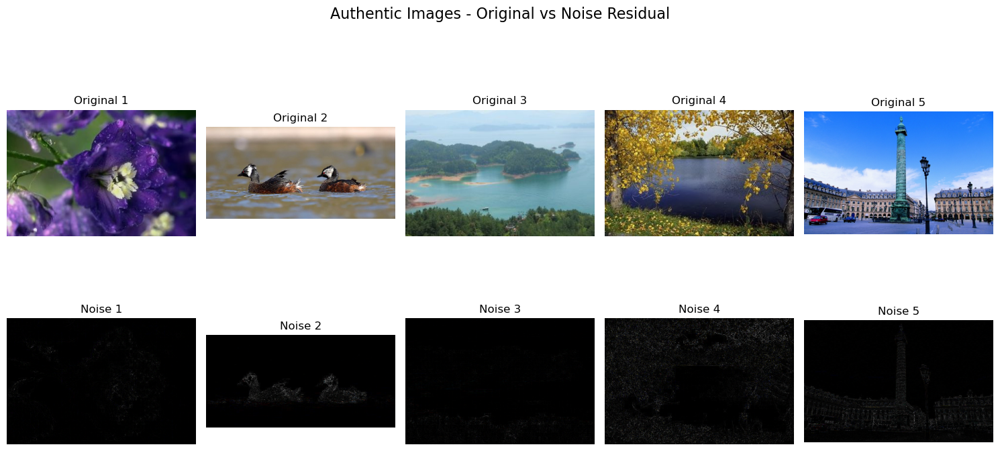

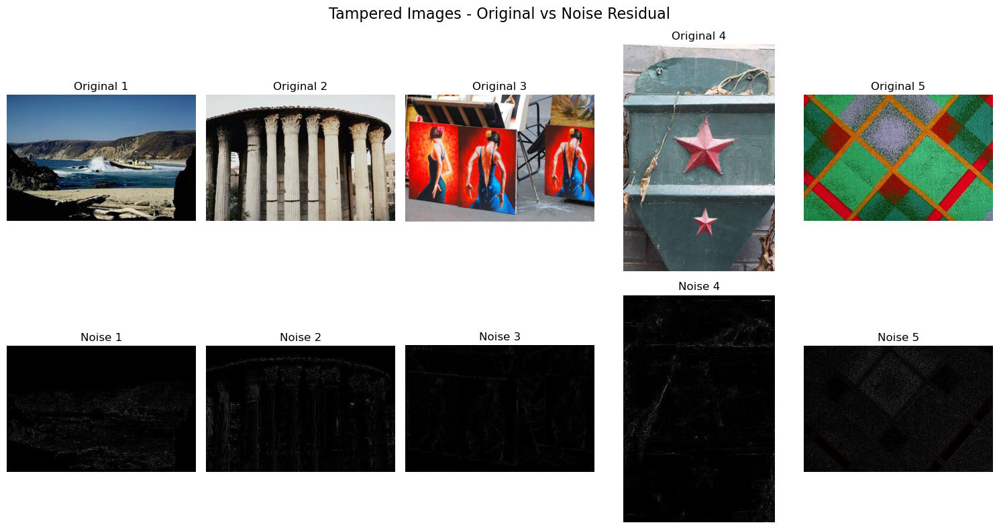

Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_156 (Conv2D)         (None, 62, 62, 32)        896       
                                                                 
 max_pooling2d_69 (MaxPoolin  (None, 31, 31, 32)       0         
 g2D)                                                            
                                                                 
 dropout_117 (Dropout)       (None, 31, 31, 32)        0         
                                                                 
 conv2d_157 (Conv2D)         (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_70 (MaxPoolin  (None, 14, 14, 64)       0         
 g2D)                                                            
                                                                 
 dropout_118 (Dropout)       (None, 14, 14, 64)      

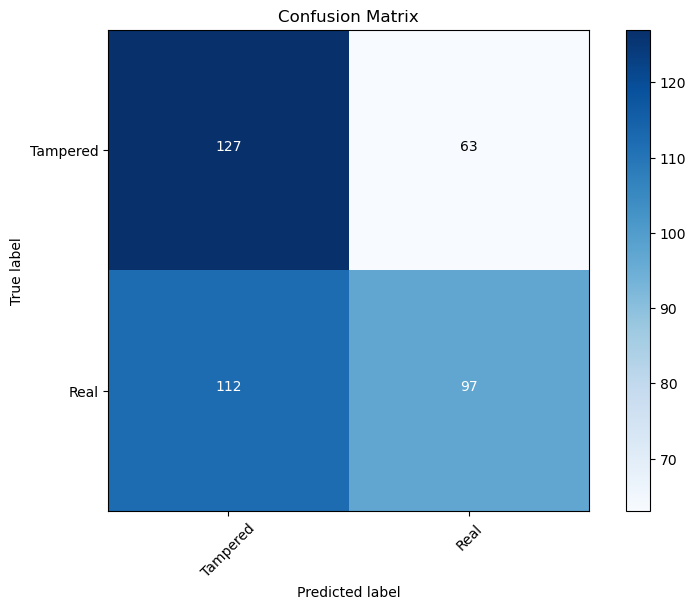

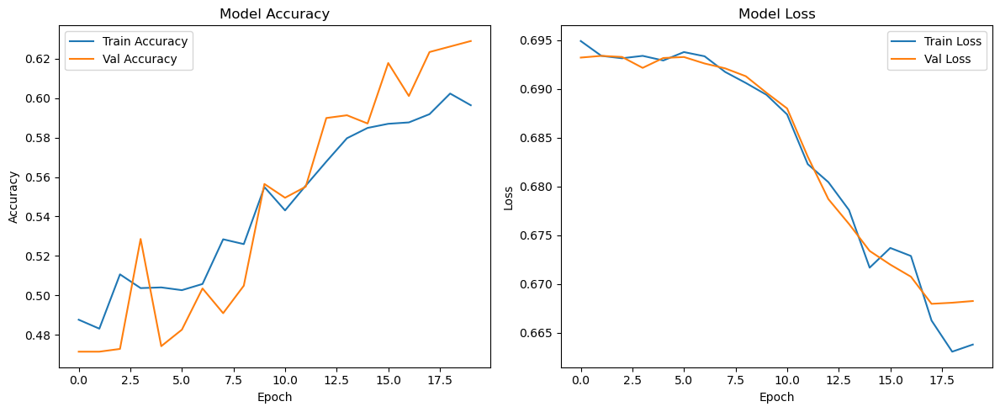


Sample predictions:
1/1 [==============================] - 0s 25ms/step
Image: Au_pla_30322.jpg
  Prediction: Real with 55.47% confidence
1/1 [==============================] - 0s 30ms/step
Image: Au_ani_10197.jpg
  Prediction: Real with 68.28% confidence
1/1 [==============================] - 0s 25ms/step
Image: Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg
  Prediction: Real with 55.69% confidence
1/1 [==============================] - 0s 23ms/step
Image: Tp_S_NND_S_N_arc00012_arc00012_01111.tif
  Prediction: Tampered with 58.31% confidence


In [29]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Dropout, Flatten, Dense
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

tf.keras.mixed_precision.set_global_policy('mixed_float16')

def convert_to_noise_residual(path):
    image = Image.open(path).convert('RGB')
    median = image.filter(ImageFilter.MedianFilter(size=3))
    residual = np.abs(np.array(image, dtype=np.float32) - np.array(median, dtype=np.float32))
    residual = np.clip(residual, 0, 255).astype(np.uint8)
    return Image.fromarray(residual)

def prepare_image_noise(image_path, target_size=(64, 64)):
    return np.array(convert_to_noise_residual(image_path).resize(target_size)) / 255.0

au_path = "/kaggle/input/casia-dataset/CASIA2/Au"
tp_path = "/kaggle/input/casia-dataset/CASIA2/Tp"

X, Y = [], []
print("Loading authentic images...")
for img_name in os.listdir(au_path)[:2000]:
    img_path = os.path.join(au_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_noise(img_path))
        Y.append(1)
print("Loading tampered images...")
for img_name in os.listdir(tp_path)[:2000]:
    img_path = os.path.join(tp_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_noise(img_path))
        Y.append(0)

X = np.array(X)
Y = to_categorical(Y, 2)

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)

def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

def display_samples(image_paths, title):
    plt.figure(figsize=(15, 8))
    plt.suptitle(title, fontsize=16)
    for i, img_path in enumerate(image_paths[:5]):
        plt.subplot(2, 5, i+1)
        orig_img = Image.open(img_path)
        plt.imshow(orig_img)
        plt.title(f"Original {i+1}")
        plt.axis('off')
        plt.subplot(2, 5, i+6)
        noise_img = convert_to_noise_residual(img_path)
        plt.imshow(noise_img)
        plt.title(f"Noise {i+1}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

au_images = [os.path.join(au_path, f) for f in os.listdir(au_path) if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(au_images, "Authentic Images - Original vs Noise Residual")
tp_images = [os.path.join(tp_path, f) for f in os.listdir(tp_path) if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(tp_images, "Tampered Images - Original vs Noise Residual")

def build_model(input_shape=(64, 64, 3)):
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        Conv2D(64, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        Conv2D(128, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        Flatten(),
        Dense(256, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax', dtype='float32')
    ])
    return model

model = build_model()
model.summary()
optimizer = Adam(learning_rate=0.001)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

print("\nTraining model...")
history = model.fit(
    X_train, Y_train,
    batch_size=64,
    epochs=20,
    validation_data=(X_val, Y_val),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

model.save('noise_residual_model.h5')
print("Model saved as 'noise_residual_model.h5'")

print("\nEvaluating model...")
test_loss, test_acc = model.evaluate(X_test, Y_test, verbose=0)
print(f"\nTest Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

Y_pred = model.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_true = np.argmax(Y_test, axis=1)

print("\nClassification Report:")
print(classification_report(Y_true, Y_pred_classes, target_names=['Tampered', 'Real']))

confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
plt.figure(figsize=(8, 6))
plot_confusion_matrix(confusion_mtx, classes=['Tampered', 'Real'])
plt.title('Confusion Matrix')
plt.show()

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.tight_layout()
plt.show()

def predict_image(model, image_path):
    image = prepare_image_noise(image_path)
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)
    class_idx = np.argmax(prediction)
    confidence = np.max(prediction)
    return "Real" if class_idx == 1 else "Tampered", confidence

print("\nSample predictions:")
for img_path in au_images[:2] + tp_images[:2]:
    prediction, confidence = predict_image(model, img_path)
    print(f"Image: {os.path.basename(img_path)}")
    print(f"  Prediction: {prediction} with {confidence*100:.2f}% confidence")

# pixel level

Loading authentic images with pixel-level analysis...
Loading tampered images with pixel-level analysis...
Final dataset shape: (3983, 64, 64, 10)
Feature channels: RGB(3) + Gradient(1) + Laplacian(1) + Noise(1) + LBP(1) + HSV(3) = 10 channels

Data shapes:
Train: (2867, 64, 64, 10) (2867, 2)
Val: (717, 64, 64, 10) (717, 2)
Test: (399, 64, 64, 10) (399, 2)


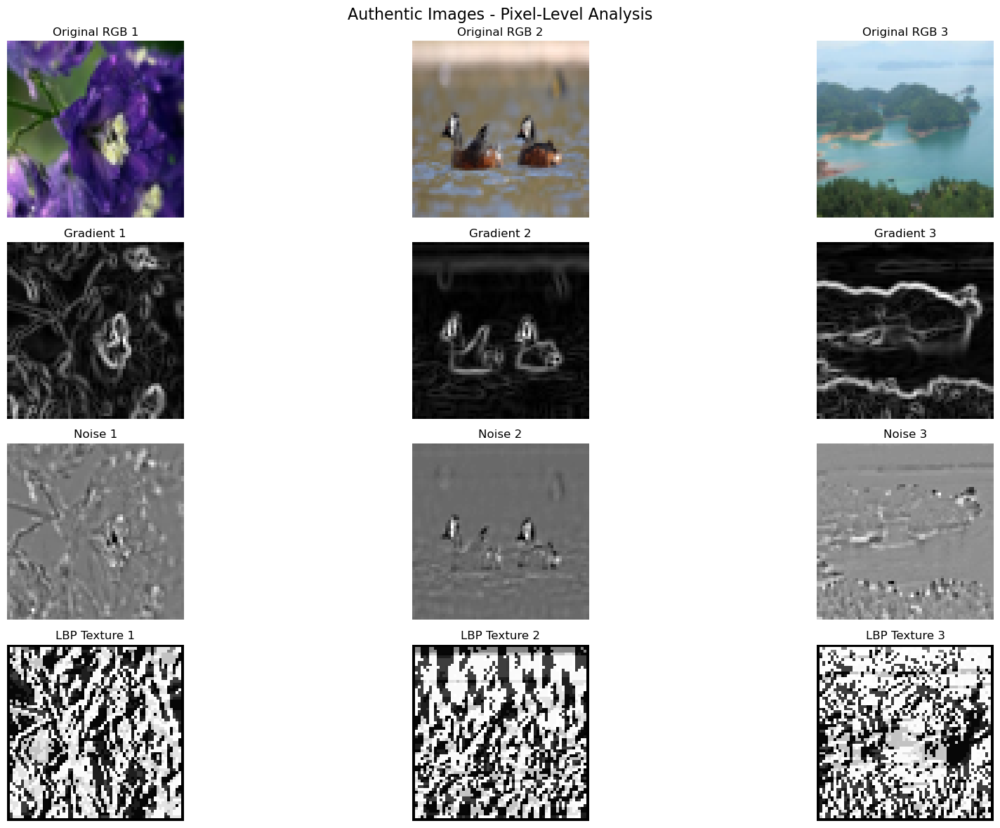

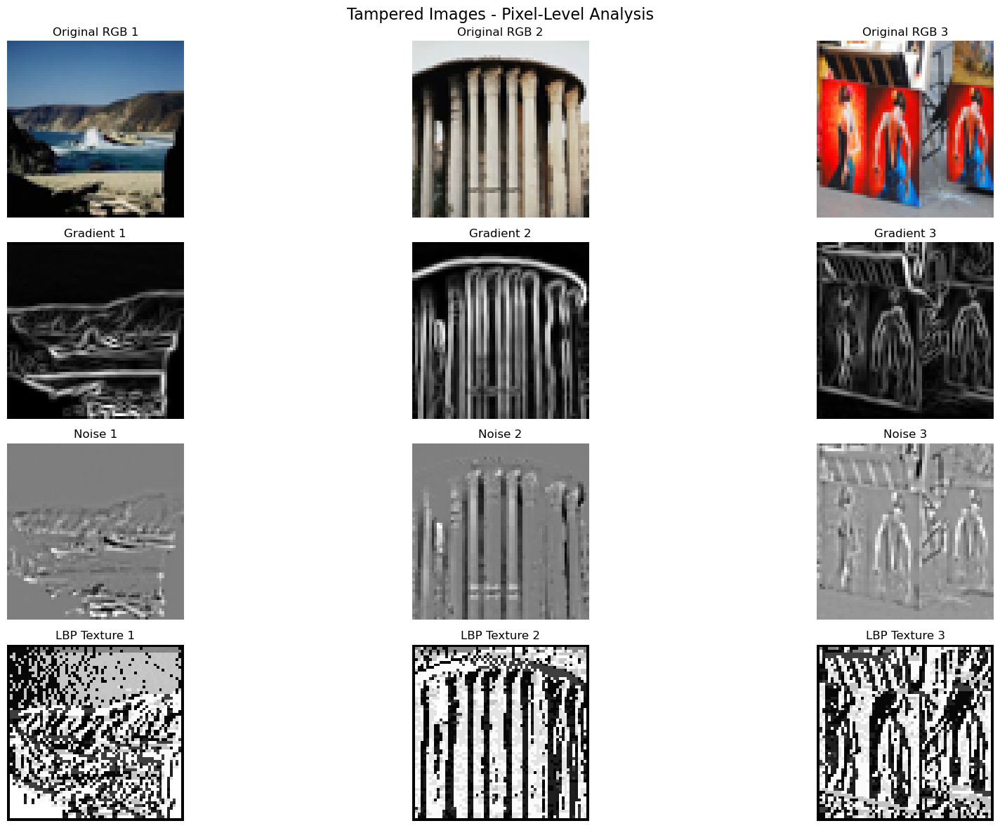

Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_149 (Conv2D)         (None, 62, 62, 32)        2912      
                                                                 
 batch_normalization_62 (Bat  (None, 62, 62, 32)       128       
 chNormalization)                                                
                                                                 
 conv2d_150 (Conv2D)         (None, 60, 60, 32)        9248      
                                                                 
 max_pooling2d_66 (MaxPoolin  (None, 30, 30, 32)       0         
 g2D)                                                            
                                                                 
 dropout_111 (Dropout)       (None, 30, 30, 32)        0         
                                                                 
 conv2d_151 (Conv2D)         (None, 28, 28, 64)      

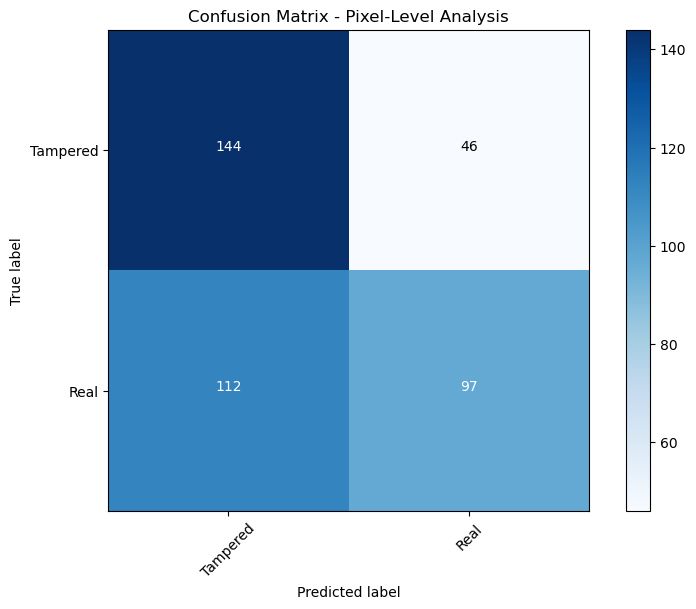

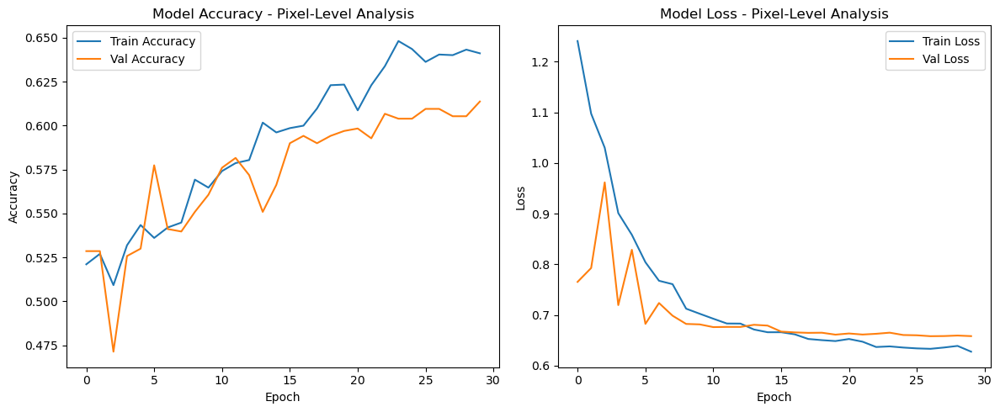


Sample predictions with pixel-level analysis:
1/1 [==============================] - 0s 29ms/step
Image: Au_pla_30322.jpg
  Prediction: Tampered with 52.60% confidence
1/1 [==============================] - 0s 25ms/step
Image: Au_ani_10197.jpg
  Prediction: Tampered with 68.32% confidence
1/1 [==============================] - 0s 22ms/step
Image: Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg
  Prediction: Tampered with 61.30% confidence
1/1 [==============================] - 0s 22ms/step
Image: Tp_S_NND_S_N_arc00012_arc00012_01111.tif
  Prediction: Real with 65.08% confidence

Feature Channel Analysis:
Channel 0-2: RGB color information
Channel 3: Gradient magnitude (edge detection)
Channel 4: Laplacian (second derivatives)
Channel 5: Noise patterns
Channel 6: Local Binary Pattern (texture)
Channel 7-9: HSV color space


In [28]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Dropout, Flatten, Dense, BatchNormalization
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf
import cv2
from scipy import ndimage

# Enable mixed precision for faster training (uses FP16 where possible)
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Pixel-level analysis functions
def compute_pixel_statistics(image):
    """Compute pixel-level statistical features"""
    # Convert to grayscale for analysis
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Compute gradients
    grad_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
    
    # Gradient magnitude
    gradient_magnitude = np.sqrt(grad_x**2 + grad_y**2)
    
    # Laplacian (second derivative)
    laplacian = cv2.Laplacian(gray, cv2.CV_64F)
    
    return gradient_magnitude, laplacian

def noise_analysis(image):
    """Analyze noise patterns in the image"""
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Apply median filter to get denoised version
    denoised = cv2.medianBlur(gray, 5)
    
    # Noise is the difference between original and denoised
    noise = gray.astype(np.float32) - denoised.astype(np.float32)
    
    # Normalize noise
    noise = (noise - noise.min()) / (noise.max() - noise.min() + 1e-8)
    
    return noise

def local_binary_pattern(image, radius=1, n_points=8):
    """Compute Local Binary Pattern for texture analysis"""
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Simple LBP implementation
    h, w = gray.shape
    lbp = np.zeros_like(gray)
    
    for i in range(radius, h - radius):
        for j in range(radius, w - radius):
            center = gray[i, j]
            code = 0
            for k in range(n_points):
                angle = 2 * np.pi * k / n_points
                x = int(i + radius * np.cos(angle))
                y = int(j + radius * np.sin(angle))
                if x < h and y < w and gray[x, y] >= center:
                    code |= (1 << k)
            lbp[i, j] = code
    
    return lbp / 255.0  # Normalize

def pixel_level_analysis(image_path, target_size=(64, 64)):
    """Perform comprehensive pixel-level analysis"""
    # Load and resize image
    image = Image.open(image_path).convert('RGB')
    image = image.resize(target_size)
    image_array = np.array(image)
    
    # 1. Original RGB channels
    rgb_normalized = image_array / 255.0
    
    # 2. Gradient analysis
    gradient_mag, laplacian = compute_pixel_statistics(image_array)
    gradient_mag = cv2.resize(gradient_mag, target_size) / 255.0
    laplacian = cv2.resize(laplacian, target_size)
    laplacian = (laplacian - laplacian.min()) / (laplacian.max() - laplacian.min() + 1e-8)
    
    # 3. Noise analysis
    noise = noise_analysis(image_array)
    noise = cv2.resize(noise, target_size)
    
    # 4. Texture analysis (LBP)
    lbp = local_binary_pattern(image_array)
    lbp = cv2.resize(lbp, target_size)
    
    # 5. Color channel statistics
    # Convert to different color spaces for analysis
    hsv = cv2.cvtColor(image_array, cv2.COLOR_RGB2HSV)
    hsv = cv2.resize(hsv, target_size) / 255.0
    
    # Combine all features into multi-channel representation
    # Stack: RGB(3) + Gradient(1) + Laplacian(1) + Noise(1) + LBP(1) + HSV(3) = 10 channels
    features = np.dstack([
        rgb_normalized,                    # RGB channels (3)
        gradient_mag[..., np.newaxis],     # Gradient magnitude (1)
        laplacian[..., np.newaxis],        # Laplacian (1)
        noise[..., np.newaxis],            # Noise (1)
        lbp[..., np.newaxis],              # LBP texture (1)
        hsv                                # HSV channels (3)
    ])
    
    return features

def prepare_image_pixel_analysis(image_path, target_size=(64, 64)):
    """Wrapper function for pixel-level analysis"""
    return pixel_level_analysis(image_path, target_size)

# Define paths
au_path = "/kaggle/input/casia-dataset/CASIA2/Au"  # Authentic images
tp_path = "/kaggle/input/casia-dataset/CASIA2/Tp"  # Tampered images

# Initialize lists
X = []  # Images
Y = []  # Labels (0=Tampered, 1=Authentic)

print("Loading authentic images with pixel-level analysis...")
for img_name in os.listdir(au_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(au_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        try:
            features = prepare_image_pixel_analysis(img_path)
            X.append(features)
            Y.append(1)  # Label 1 = Authentic
        except Exception as e:
            print(f"Error processing {img_name}: {e}")
            continue

print("Loading tampered images with pixel-level analysis...")
for img_name in os.listdir(tp_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(tp_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        try:
            features = prepare_image_pixel_analysis(img_path)
            X.append(features)
            Y.append(0)  # Label 0 = Tampered
        except Exception as e:
            print(f"Error processing {img_name}: {e}")
            continue

# Convert to numpy arrays
X = np.array(X)
Y = to_categorical(Y, 2)  # One-hot encoding

print(f"Final dataset shape: {X.shape}")
print(f"Feature channels: RGB(3) + Gradient(1) + Laplacian(1) + Noise(1) + LBP(1) + HSV(3) = {X.shape[-1]} channels")

# Split into Train, Validation, Test
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)

print("\nData shapes:")
print("Train:", X_train.shape, Y_train.shape)
print("Val:", X_val.shape, Y_val.shape)
print("Test:", X_test.shape, Y_test.shape)

# Visualization function
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Enhanced visualization for pixel-level features
def display_pixel_analysis_samples(image_paths, title):
    plt.figure(figsize=(20, 12))
    plt.suptitle(title, fontsize=16)
    
    for i, img_path in enumerate(image_paths[:3]):
        features = pixel_level_analysis(img_path)
        
        # Original Image (RGB)
        plt.subplot(4, 3, i+1)
        plt.imshow(features[:, :, :3])
        plt.title(f"Original RGB {i+1}")
        plt.axis('off')
        
        # Gradient Magnitude
        plt.subplot(4, 3, i+4)
        plt.imshow(features[:, :, 3], cmap='gray')
        plt.title(f"Gradient {i+1}")
        plt.axis('off')
        
        # Noise Pattern
        plt.subplot(4, 3, i+7)
        plt.imshow(features[:, :, 5], cmap='gray')
        plt.title(f"Noise {i+1}")
        plt.axis('off')
        
        # LBP Texture
        plt.subplot(4, 3, i+10)
        plt.imshow(features[:, :, 6], cmap='gray')
        plt.title(f"LBP Texture {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Show sample analysis
au_images = [os.path.join(au_path, f) for f in os.listdir(au_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:3]
display_pixel_analysis_samples(au_images, "Authentic Images - Pixel-Level Analysis")

tp_images = [os.path.join(tp_path, f) for f in os.listdir(tp_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:3]
display_pixel_analysis_samples(tp_images, "Tampered Images - Pixel-Level Analysis")

# Enhanced model architecture for multi-channel input
def build_pixel_analysis_model(input_shape=(64, 64, 10)):
    model = Sequential([
        # First block - handle multi-channel input
        Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        BatchNormalization(),
        Conv2D(32, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        # Second block
        Conv2D(64, (3, 3), activation='relu'),
        BatchNormalization(),
        Conv2D(64, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        # Third block
        Conv2D(128, (3, 3), activation='relu'),
        BatchNormalization(),
        Conv2D(128, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        # Fourth block
        Conv2D(256, (3, 3), activation='relu'),
        BatchNormalization(),
        Dropout(0.25),
        
        # Classifier
        Flatten(),
        Dense(512, activation='relu'),
        BatchNormalization(),
        Dropout(0.5),
        Dense(256, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax', dtype='float32')  # Ensure output is float32
    ])
    return model

# Build model
model_pixel = build_pixel_analysis_model(input_shape=X.shape[1:])
model_pixel.summary()

# Optimizer with learning rate schedule
optimizer = Adam(learning_rate=0.0005)  # Slightly lower learning rate for complex features
model_pixel.compile(optimizer=optimizer, 
                   loss='categorical_crossentropy', 
                   metrics=['accuracy'])

# Callbacks
early_stop = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=4, min_lr=1e-7)

# Train model
print("\nTraining pixel-level analysis model...")
history_pixel = model_pixel.fit(
    X_train, Y_train,
    batch_size=32,  # Smaller batch size due to larger input
    epochs=30,
    validation_data=(X_val, Y_val),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

# Save model
model_pixel.save('pixel_analysis_model.h5')
print("Model saved as 'pixel_analysis_model.h5'")

# Evaluate model
print("\nEvaluating model...")
test_loss, test_acc = model_pixel.evaluate(X_test, Y_test, verbose=0)
print(f"\nTest Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Predictions
Y_pred = model_pixel.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_true = np.argmax(Y_test, axis=1)

# Classification Report
print("\nClassification Report:")
print(classification_report(Y_true, Y_pred_classes, target_names=['Tampered', 'Real']))

# Confusion Matrix
confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
plt.figure(figsize=(8, 6))
plot_confusion_matrix(confusion_mtx, classes=['Tampered', 'Real'])
plt.title('Confusion Matrix - Pixel-Level Analysis')
plt.show()

# Plot training history
plt.figure(figsize=(12, 5))

# Accuracy plot
plt.subplot(1, 2, 1)
plt.plot(history_pixel.history['accuracy'], label='Train Accuracy')
plt.plot(history_pixel.history['val_accuracy'], label='Val Accuracy')
plt.title('Model Accuracy - Pixel-Level Analysis')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()

# Loss plot
plt.subplot(1, 2, 2)
plt.plot(history_pixel.history['loss'], label='Train Loss')
plt.plot(history_pixel.history['val_loss'], label='Val Loss')
plt.title('Model Loss - Pixel-Level Analysis')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()

plt.tight_layout()
plt.show()

# Sample predictions
def predict_image_pixel(model, image_path):
    features = prepare_image_pixel_analysis(image_path)
    features = np.expand_dims(features, axis=0)
    prediction = model.predict(features)
    class_idx = np.argmax(prediction)
    confidence = np.max(prediction)
    return "Real" if class_idx == 1 else "Tampered", confidence

# Test on sample images
print("\nSample predictions with pixel-level analysis:")
for img_path in au_images[:2] + tp_images[:2]:
    prediction, confidence = predict_image_pixel(model_pixel, img_path)
    print(f"Image: {os.path.basename(img_path)}")
    print(f"  Prediction: {prediction} with {confidence*100:.2f}% confidence")

# Feature importance analysis
def analyze_feature_channels():
    """Analyze which feature channels are most important"""
    print("\nFeature Channel Analysis:")
    print("Channel 0-2: RGB color information")
    print("Channel 3: Gradient magnitude (edge detection)")
    print("Channel 4: Laplacian (second derivatives)")
    print("Channel 5: Noise patterns")
    print("Channel 6: Local Binary Pattern (texture)")
    print("Channel 7-9: HSV color space")
    
    # You can extend this to show actual feature importance if needed

analyze_feature_channels()

# Sobel Edge

Loading authentic images...
Loading tampered images...

Data shapes:
Train: (2867, 64, 64, 3) (2867, 2)
Val: (717, 64, 64, 3) (717, 2)
Test: (399, 64, 64, 3) (399, 2)


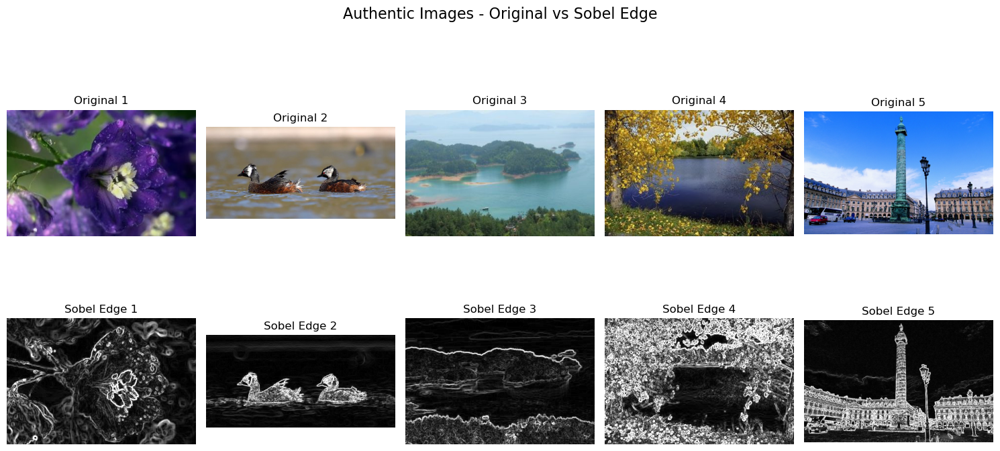

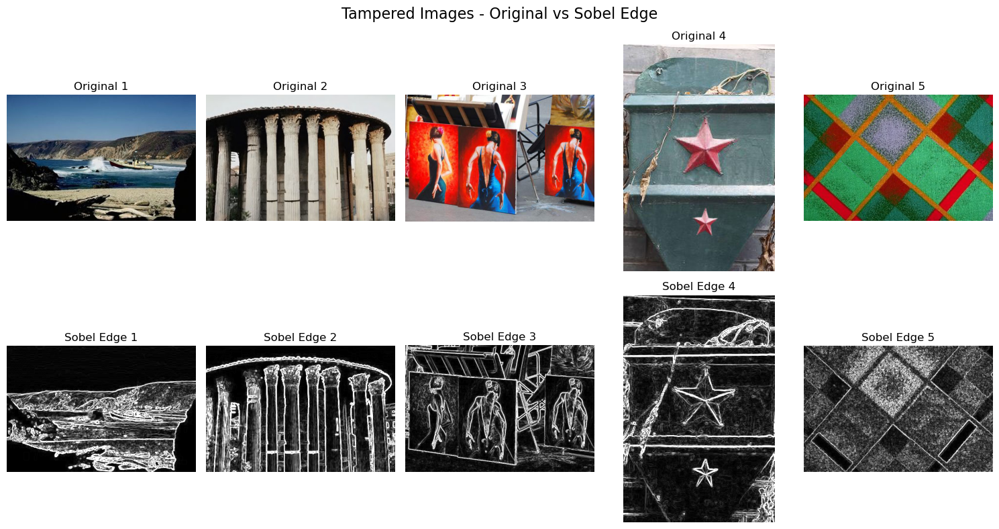

Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_159 (Conv2D)         (None, 62, 62, 32)        896       
                                                                 
 max_pooling2d_72 (MaxPoolin  (None, 31, 31, 32)       0         
 g2D)                                                            
                                                                 
 dropout_121 (Dropout)       (None, 31, 31, 32)        0         
                                                                 
 conv2d_160 (Conv2D)         (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_73 (MaxPoolin  (None, 14, 14, 64)       0         
 g2D)                                                            
                                                                 
 dropout_122 (Dropout)       (None, 14, 14, 64)      

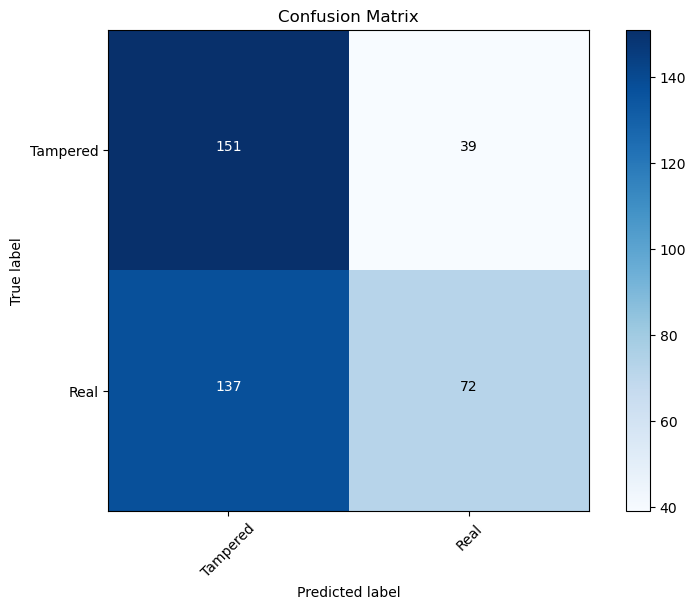

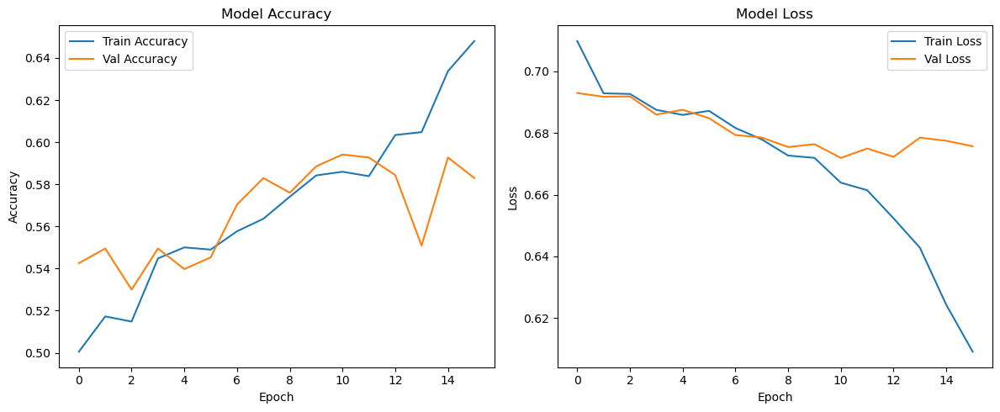


Sample predictions:
1/1 [==============================] - 0s 23ms/step
Image: Au_pla_30322.jpg
  Prediction: Tampered with 55.81% confidence
1/1 [==============================] - 0s 21ms/step
Image: Au_ani_10197.jpg
  Prediction: Real with 69.27% confidence
1/1 [==============================] - 0s 23ms/step
Image: Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg
  Prediction: Tampered with 55.46% confidence
1/1 [==============================] - 0s 21ms/step
Image: Tp_S_NND_S_N_arc00012_arc00012_01111.tif
  Prediction: Tampered with 52.72% confidence


In [31]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from scipy.ndimage import sobel
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Dropout, Flatten, Dense
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

tf.keras.mixed_precision.set_global_policy('mixed_float16')

def convert_to_sobel_edge(path):
    image = Image.open(path).convert('L')
    arr = np.array(image, dtype=np.float32)
    sx = sobel(arr, axis=0)
    sy = sobel(arr, axis=1)
    edge = np.hypot(sx, sy)
    edge = np.clip(edge, 0, 255).astype(np.uint8)
    edge_rgb = np.stack([edge]*3, axis=-1)
    return Image.fromarray(edge_rgb)

def prepare_image_sobel(image_path, target_size=(64, 64)):
    return np.array(convert_to_sobel_edge(image_path).resize(target_size)) / 255.0

# Define paths
au_path = "/kaggle/input/casia-dataset/CASIA2/Au"  # Authentic images
tp_path = "/kaggle/input/casia-dataset/CASIA2/Tp"  # Tampered images

# Initialize lists
X = []  # Images
Y = []  # Labels (0=Tampered, 1=Authentic)

print("Loading authentic images...")
for img_name in os.listdir(au_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(au_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_sobel(img_path))
        Y.append(1)  # Label 1 = Authentic

print("Loading tampered images...")
for img_name in os.listdir(tp_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(tp_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_sobel(img_path))
        Y.append(0)  # Label 0 = Tampered

# Convert to numpy arrays
X = np.array(X)
Y = to_categorical(Y, 2)  # One-hot encoding

# Split into Train, Validation, Test
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)

print("\nData shapes:")
print("Train:", X_train.shape, Y_train.shape)
print("Val:", X_val.shape, Y_val.shape)
print("Test:", X_test.shape, Y_test.shape)

# Visualization function
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Show sample images
def display_samples(image_paths, title):
    plt.figure(figsize=(15, 8))
    plt.suptitle(title, fontsize=16)
    
    for i, img_path in enumerate(image_paths[:5]):
        # Original Image
        plt.subplot(2, 5, i+1)
        orig_img = Image.open(img_path)
        plt.imshow(orig_img)
        plt.title(f"Original {i+1}")
        plt.axis('off')
        
        # Sobel Edge Processed Image
        plt.subplot(2, 5, i+6)
        sobel_img = convert_to_sobel_edge(img_path)
        plt.imshow(sobel_img)
        plt.title(f"Sobel Edge {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Authentic images
au_images = [os.path.join(au_path, f) for f in os.listdir(au_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(au_images, "Authentic Images - Original vs Sobel Edge")

# Tampered images
tp_images = [os.path.join(tp_path, f) for f in os.listdir(tp_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(tp_images, "Tampered Images - Original vs Sobel Edge")

# Simplified model architecture
def build_model(input_shape=(64, 64, 3)):
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(64, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(128, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Flatten(),
        Dense(256, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax', dtype='float32')  # Ensure output is float32
    ])
    return model

# Build model
model = build_model()
model.summary()

# Optimizer with learning rate schedule
optimizer = Adam(learning_rate=0.001)
model.compile(optimizer=optimizer, 
              loss='categorical_crossentropy', 
              metrics=['accuracy'])

# Callbacks
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

# Train model
print("\nTraining model...")
history = model.fit(
    X_train, Y_train,
    batch_size=64,  # Increased batch size for faster processing
    epochs=20,
    validation_data=(X_val, Y_val),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

# Save model
model.save('sobel_edge_model.h5')
print("Model saved as 'sobel_edge_model.h5'")

# Evaluate model
print("\nEvaluating model...")
test_loss, test_acc = model.evaluate(X_test, Y_test, verbose=0)
print(f"\nTest Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Predictions
Y_pred = model.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_true = np.argmax(Y_test, axis=1)

# Classification Report
print("\nClassification Report:")
print(classification_report(Y_true, Y_pred_classes, target_names=['Tampered', 'Real']))

# Confusion Matrix
confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
plt.figure(figsize=(8, 6))
plot_confusion_matrix(confusion_mtx, classes=['Tampered', 'Real'])
plt.title('Confusion Matrix')
plt.show()

# Plot training history
plt.figure(figsize=(12, 5))

# Accuracy plot
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()

# Loss plot
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()

plt.tight_layout()
plt.show()

# Sample predictions
def predict_image(model, image_path):
    image = prepare_image_sobel(image_path)
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)
    class_idx = np.argmax(prediction)
    confidence = np.max(prediction)
    return "Real" if class_idx == 1 else "Tampered", confidence

# Test on sample images
print("\nSample predictions:")
for img_path in au_images[:2] + tp_images[:2]:
    prediction, confidence = predict_image(model, img_path)
    print(f"Image: {os.path.basename(img_path)}")
    print(f"  Prediction: {prediction} with {confidence*100:.2f}% confidence")

# Laplacian Edge

Loading authentic images...
Loading tampered images...


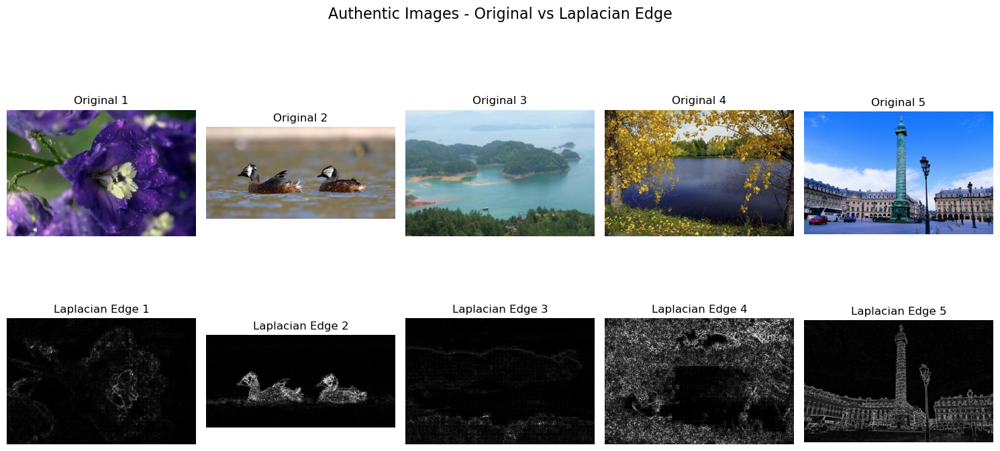

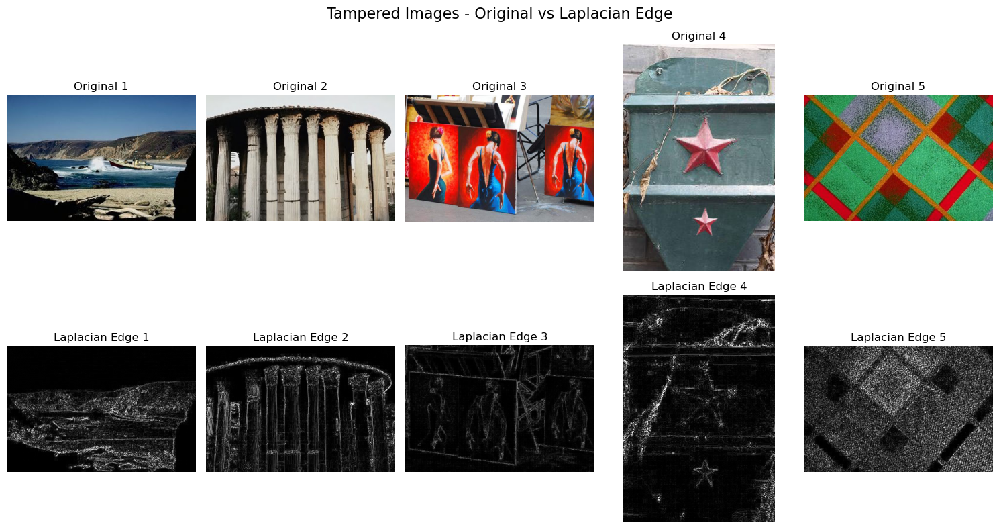

Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_165 (Conv2D)         (None, 62, 62, 32)        896       
                                                                 
 max_pooling2d_78 (MaxPoolin  (None, 31, 31, 32)       0         
 g2D)                                                            
                                                                 
 dropout_129 (Dropout)       (None, 31, 31, 32)        0         
                                                                 
 conv2d_166 (Conv2D)         (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_79 (MaxPoolin  (None, 14, 14, 64)       0         
 g2D)                                                            
                                                                 
 dropout_130 (Dropout)       (None, 14, 14, 64)      

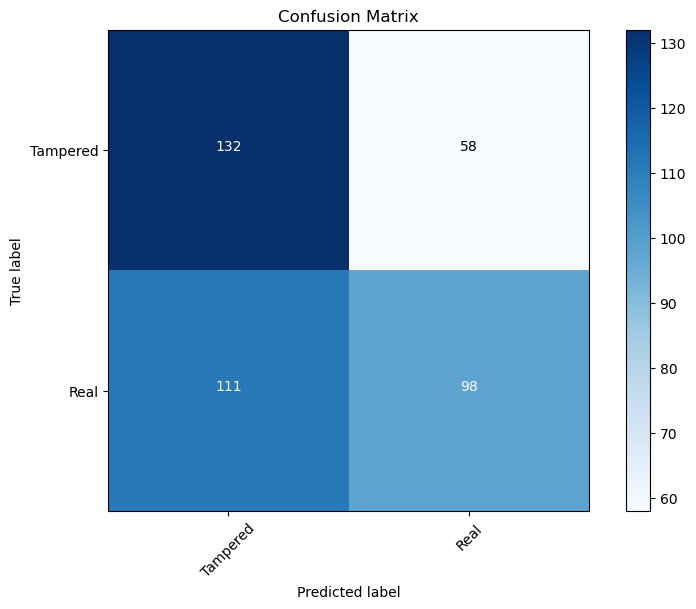

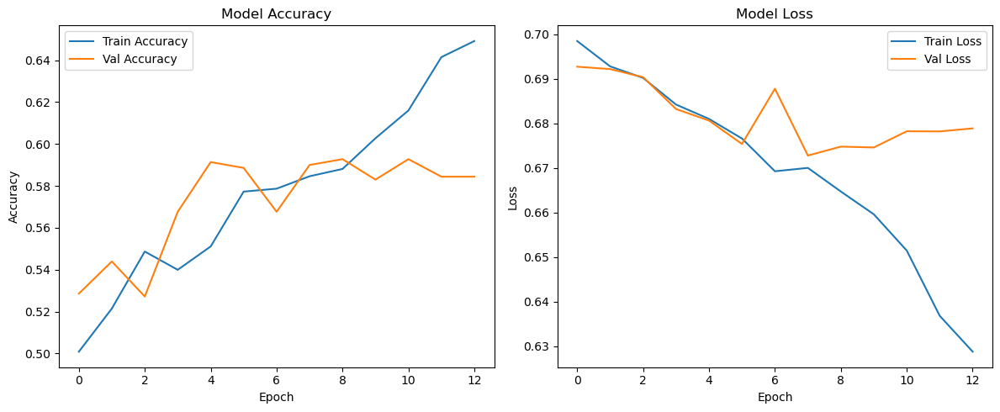


Sample predictions:
1/1 [==============================] - 0s 23ms/step
Image: Au_pla_30322.jpg
  Prediction: Tampered with 54.31% confidence
1/1 [==============================] - 0s 20ms/step
Image: Au_ani_10197.jpg
  Prediction: Real with 68.76% confidence
1/1 [==============================] - 0s 33ms/step
Image: Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg
  Prediction: Real with 55.48% confidence
1/1 [==============================] - 0s 20ms/step
Image: Tp_S_NND_S_N_arc00012_arc00012_01111.tif
  Prediction: Tampered with 62.17% confidence


In [33]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from scipy.ndimage import laplace
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Dropout, Flatten, Dense
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

tf.keras.mixed_precision.set_global_policy('mixed_float16')

def convert_to_laplacian_edge(path):
    image = Image.open(path).convert('L')
    arr = np.array(image, dtype=np.float32)
    edge = np.abs(laplace(arr))
    edge = np.clip(edge, 0, 255).astype(np.uint8)
    edge_rgb = np.stack([edge]*3, axis=-1)
    return Image.fromarray(edge_rgb)

def prepare_image_laplacian(image_path, target_size=(64, 64)):
    return np.array(convert_to_laplacian_edge(image_path).resize(target_size)) / 255.0

au_path = "/kaggle/input/casia-dataset/CASIA2/Au"
tp_path = "/kaggle/input/casia-dataset/CASIA2/Tp"

X, Y = [], []
print("Loading authentic images...")
for img_name in os.listdir(au_path)[:2000]:
    img_path = os.path.join(au_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_laplacian(img_path))
        Y.append(1)
print("Loading tampered images...")
for img_name in os.listdir(tp_path)[:2000]:
    img_path = os.path.join(tp_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_laplacian(img_path))
        Y.append(0)

X = np.array(X)
Y = to_categorical(Y, 2)

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)

def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

def display_samples(image_paths, title):
    plt.figure(figsize=(15, 8))
    plt.suptitle(title, fontsize=16)
    for i, img_path in enumerate(image_paths[:5]):
        plt.subplot(2, 5, i+1)
        orig_img = Image.open(img_path)
        plt.imshow(orig_img)
        plt.title(f"Original {i+1}")
        plt.axis('off')
        plt.subplot(2, 5, i+6)
        edge_img = convert_to_laplacian_edge(img_path)
        plt.imshow(edge_img)
        plt.title(f"Laplacian Edge {i+1}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

au_images = [os.path.join(au_path, f) for f in os.listdir(au_path) if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(au_images, "Authentic Images - Original vs Laplacian Edge")
tp_images = [os.path.join(tp_path, f) for f in os.listdir(tp_path) if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(tp_images, "Tampered Images - Original vs Laplacian Edge")

def build_model(input_shape=(64, 64, 3)):
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        Conv2D(64, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        Conv2D(128, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        Flatten(),
        Dense(256, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax', dtype='float32')
    ])
    return model

model = build_model()
model.summary()
optimizer = Adam(learning_rate=0.001)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

print("\nTraining model...")
history = model.fit(
    X_train, Y_train,
    batch_size=64,
    epochs=20,
    validation_data=(X_val, Y_val),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

model.save('laplacian_edge_model.h5')
print("Model saved as 'laplacian_edge_model.h5'")

print("\nEvaluating model...")
test_loss, test_acc = model.evaluate(X_test, Y_test, verbose=0)
print(f"\nTest Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

Y_pred = model.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_true = np.argmax(Y_test, axis=1)

print("\nClassification Report:")
print(classification_report(Y_true, Y_pred_classes, target_names=['Tampered', 'Real']))

confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
plt.figure(figsize=(8, 6))
plot_confusion_matrix(confusion_mtx, classes=['Tampered', 'Real'])
plt.title('Confusion Matrix')
plt.show()

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.tight_layout()
plt.show()

def predict_image(model, image_path):
    image = prepare_image_laplacian(image_path)
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)
    class_idx = np.argmax(prediction)
    confidence = np.max(prediction)
    return "Real" if class_idx == 1 else "Tampered", confidence

print("\nSample predictions:")
for img_path in au_images[:2] + tp_images[:2]:
    prediction, confidence = predict_image(model, img_path)
    print(f"Image: {os.path.basename(img_path)}")
    print(f"  Prediction: {prediction} with {confidence*100:.2f}% confidence")

# Histogram Equalization

Loading authentic images...
Loading tampered images...


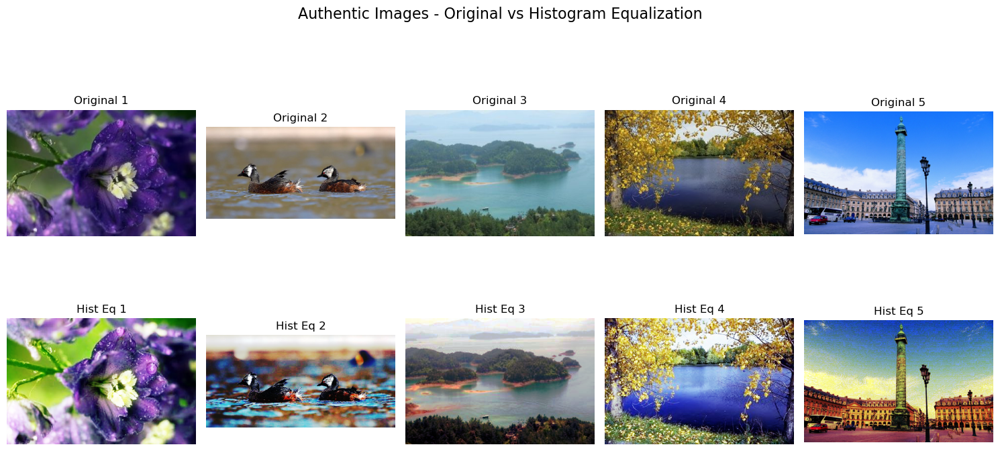

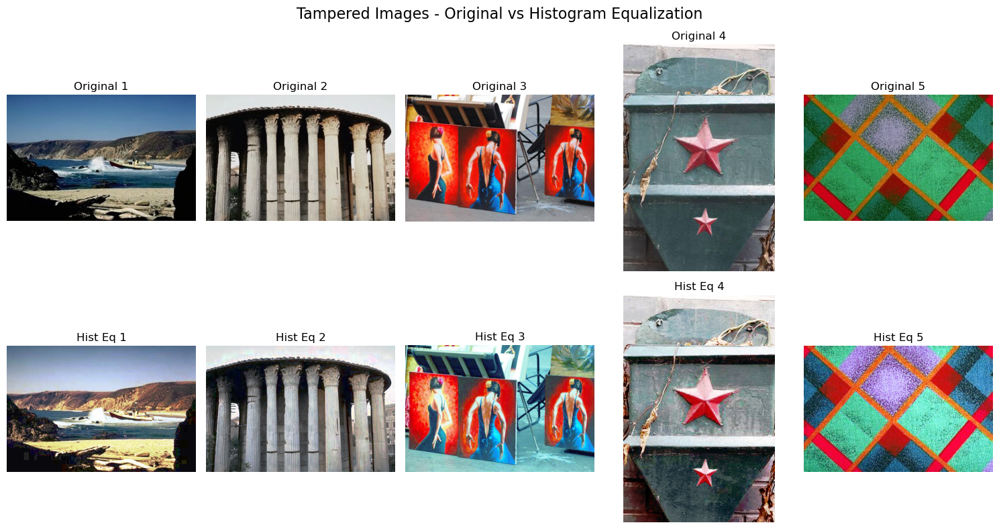

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_162 (Conv2D)         (None, 62, 62, 32)        896       
                                                                 
 max_pooling2d_75 (MaxPoolin  (None, 31, 31, 32)       0         
 g2D)                                                            
                                                                 
 dropout_125 (Dropout)       (None, 31, 31, 32)        0         
                                                                 
 conv2d_163 (Conv2D)         (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_76 (MaxPoolin  (None, 14, 14, 64)       0         
 g2D)                                                            
                                                                 
 dropout_126 (Dropout)       (None, 14, 14, 64)      

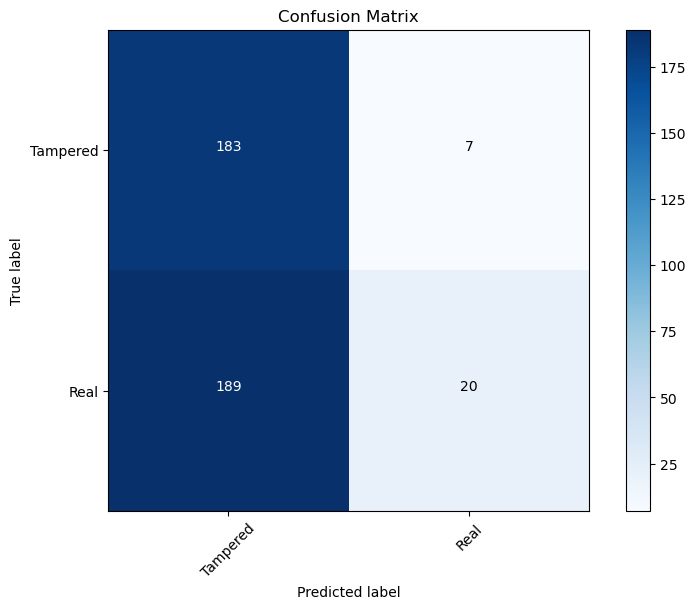

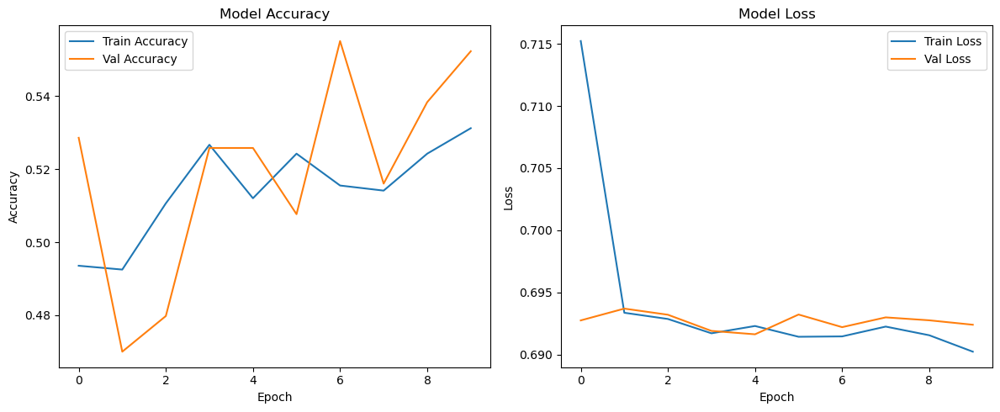


Sample predictions:
1/1 [==============================] - 0s 21ms/step
Image: Au_pla_30322.jpg
  Prediction: Tampered with 55.89% confidence
1/1 [==============================] - 0s 19ms/step
Image: Au_ani_10197.jpg
  Prediction: Tampered with 53.09% confidence
1/1 [==============================] - 0s 21ms/step
Image: Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg
  Prediction: Tampered with 52.45% confidence
1/1 [==============================] - 0s 19ms/step
Image: Tp_S_NND_S_N_arc00012_arc00012_01111.tif
  Prediction: Tampered with 50.70% confidence


In [32]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageOps
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Dropout, Flatten, Dense
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

tf.keras.mixed_precision.set_global_policy('mixed_float16')

def convert_to_hist_eq(path):
    image = Image.open(path).convert('RGB')
    r, g, b = image.split()
    r_eq = ImageOps.equalize(r)
    g_eq = ImageOps.equalize(g)
    b_eq = ImageOps.equalize(b)
    eq_img = Image.merge('RGB', (r_eq, g_eq, b_eq))
    return eq_img

def prepare_image_hist_eq(image_path, target_size=(64, 64)):
    return np.array(convert_to_hist_eq(image_path).resize(target_size)) / 255.0

au_path = "/kaggle/input/casia-dataset/CASIA2/Au"
tp_path = "/kaggle/input/casia-dataset/CASIA2/Tp"

X, Y = [], []
print("Loading authentic images...")
for img_name in os.listdir(au_path)[:2000]:
    img_path = os.path.join(au_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_hist_eq(img_path))
        Y.append(1)
print("Loading tampered images...")
for img_name in os.listdir(tp_path)[:2000]:
    img_path = os.path.join(tp_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_hist_eq(img_path))
        Y.append(0)

X = np.array(X)
Y = to_categorical(Y, 2)

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)

def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

def display_samples(image_paths, title):
    plt.figure(figsize=(15, 8))
    plt.suptitle(title, fontsize=16)
    for i, img_path in enumerate(image_paths[:5]):
        plt.subplot(2, 5, i+1)
        orig_img = Image.open(img_path)
        plt.imshow(orig_img)
        plt.title(f"Original {i+1}")
        plt.axis('off')
        plt.subplot(2, 5, i+6)
        hist_img = convert_to_hist_eq(img_path)
        plt.imshow(hist_img)
        plt.title(f"Hist Eq {i+1}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

au_images = [os.path.join(au_path, f) for f in os.listdir(au_path) if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(au_images, "Authentic Images - Original vs Histogram Equalization")
tp_images = [os.path.join(tp_path, f) for f in os.listdir(tp_path) if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(tp_images, "Tampered Images - Original vs Histogram Equalization")

def build_model(input_shape=(64, 64, 3)):
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        Conv2D(64, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        Conv2D(128, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        Flatten(),
        Dense(256, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax', dtype='float32')
    ])
    return model

model = build_model()
model.summary()
optimizer = Adam(learning_rate=0.001)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

print("\nTraining model...")
history = model.fit(
    X_train, Y_train,
    batch_size=64,
    epochs=20,
    validation_data=(X_val, Y_val),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

model.save('histogram_equalization_model.h5')
print("Model saved as 'histogram_equalization_model.h5'")

print("\nEvaluating model...")
test_loss, test_acc = model.evaluate(X_test, Y_test, verbose=0)
print(f"\nTest Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

Y_pred = model.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_true = np.argmax(Y_test, axis=1)

print("\nClassification Report:")
print(classification_report(Y_true, Y_pred_classes, target_names=['Tampered', 'Real']))

confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
plt.figure(figsize=(8, 6))
plot_confusion_matrix(confusion_mtx, classes=['Tampered', 'Real'])
plt.title('Confusion Matrix')
plt.show()

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.tight_layout()
plt.show()

def predict_image(model, image_path):
    image = prepare_image_hist_eq(image_path)
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)
    class_idx = np.argmax(prediction)
    confidence = np.max(prediction)
    return "Real" if class_idx == 1 else "Tampered", confidence

print("\nSample predictions:")
for img_path in au_images[:2] + tp_images[:2]:
    prediction, confidence = predict_image(model, img_path)
    print(f"Image: {os.path.basename(img_path)}")
    print(f"  Prediction: {prediction} with {confidence*100:.2f}% confidence")

# Highpass Filter

Loading authentic images...
Loading tampered images...

Data shapes:
Train: (2867, 64, 64, 3) (2867, 2)
Val: (717, 64, 64, 3) (717, 2)
Test: (399, 64, 64, 3) (399, 2)


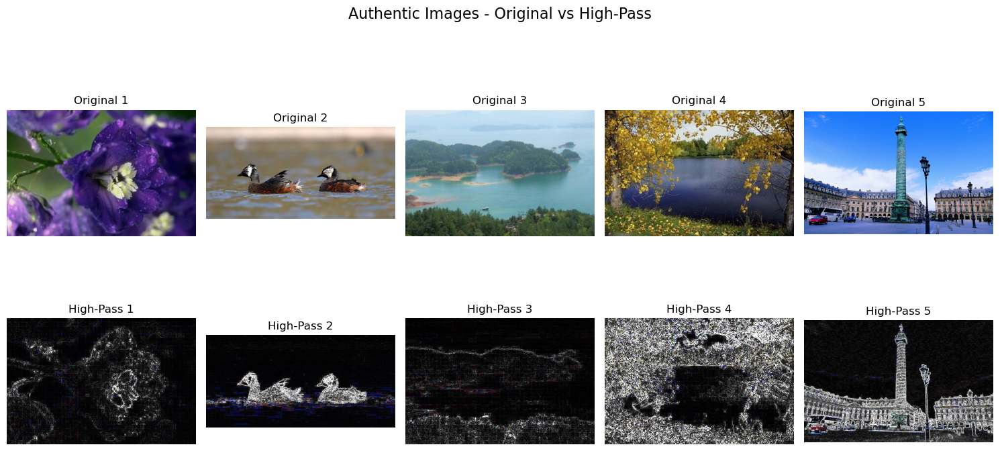

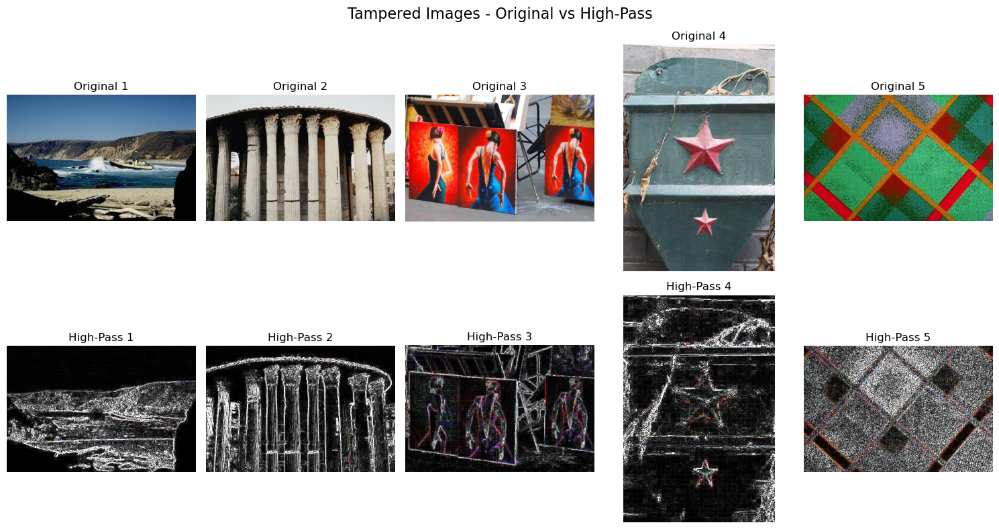

Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_168 (Conv2D)         (None, 62, 62, 32)        896       
                                                                 
 max_pooling2d_81 (MaxPoolin  (None, 31, 31, 32)       0         
 g2D)                                                            
                                                                 
 dropout_133 (Dropout)       (None, 31, 31, 32)        0         
                                                                 
 conv2d_169 (Conv2D)         (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_82 (MaxPoolin  (None, 14, 14, 64)       0         
 g2D)                                                            
                                                                 
 dropout_134 (Dropout)       (None, 14, 14, 64)      

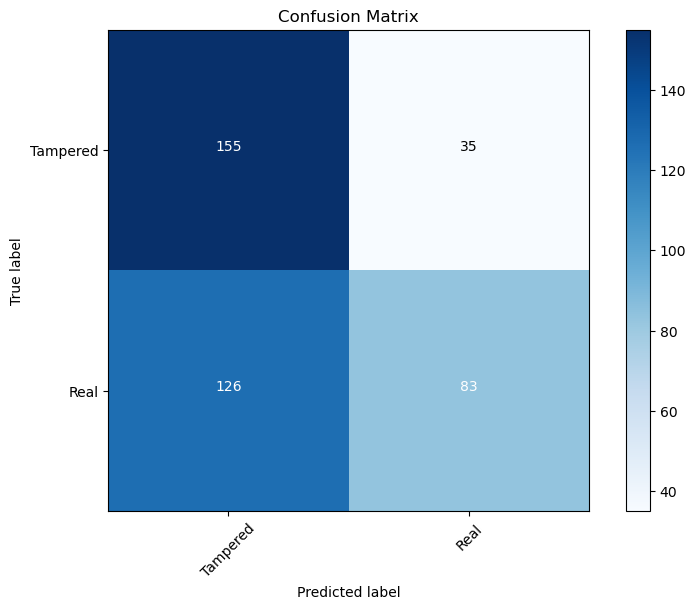

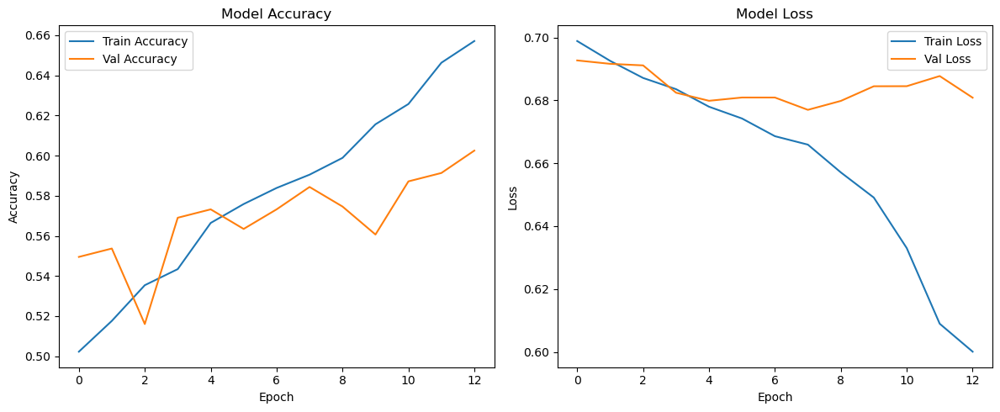


Sample predictions:
1/1 [==============================] - 0s 20ms/step
Image: Au_pla_30322.jpg
  Prediction: Real with 55.09% confidence
1/1 [==============================] - 0s 19ms/step
Image: Au_ani_10197.jpg
  Prediction: Real with 65.36% confidence
1/1 [==============================] - 0s 19ms/step
Image: Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg
  Prediction: Tampered with 59.29% confidence
1/1 [==============================] - 0s 20ms/step
Image: Tp_S_NND_S_N_arc00012_arc00012_01111.tif
  Prediction: Tampered with 54.97% confidence


In [34]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from scipy.ndimage import convolve
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Dropout, Flatten, Dense
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

tf.keras.mixed_precision.set_global_policy('mixed_float16')

def convert_to_highpass(path):
    image = Image.open(path).convert('RGB')
    arr = np.array(image, dtype=np.float32)
    kernel = np.array([[-1, -1, -1],
                       [-1,  8, -1],
                       [-1, -1, -1]])
    hp = np.zeros_like(arr)
    for c in range(3):
        hp[..., c] = convolve(arr[..., c], kernel, mode='reflect')
    hp = np.abs(hp)
    hp = np.clip(hp, 0, 255).astype(np.uint8)
    return Image.fromarray(hp)

def prepare_image_highpass(image_path, target_size=(64, 64)):
    return np.array(convert_to_highpass(image_path).resize(target_size)) / 255.0

# Define paths
au_path = "/kaggle/input/casia-dataset/CASIA2/Au"  # Authentic images
tp_path = "/kaggle/input/casia-dataset/CASIA2/Tp"  # Tampered images

# Initialize lists
X = []  # Images
Y = []  # Labels (0=Tampered, 1=Authentic)

print("Loading authentic images...")
for img_name in os.listdir(au_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(au_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_highpass(img_path))
        Y.append(1)  # Label 1 = Authentic

print("Loading tampered images...")
for img_name in os.listdir(tp_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(tp_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_highpass(img_path))
        Y.append(0)  # Label 0 = Tampered

# Convert to numpy arrays
X = np.array(X)
Y = to_categorical(Y, 2)  # One-hot encoding

# Split into Train, Validation, Test
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)

print("\nData shapes:")
print("Train:", X_train.shape, Y_train.shape)
print("Val:", X_val.shape, Y_val.shape)
print("Test:", X_test.shape, Y_test.shape)

# Visualization function
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Show sample images
def display_samples(image_paths, title):
    plt.figure(figsize=(15, 8))
    plt.suptitle(title, fontsize=16)
    
    for i, img_path in enumerate(image_paths[:5]):
        # Original Image
        plt.subplot(2, 5, i+1)
        orig_img = Image.open(img_path)
        plt.imshow(orig_img)
        plt.title(f"Original {i+1}")
        plt.axis('off')
        
        # ELA Processed Image
        plt.subplot(2, 5, i+6)
        hp_img = convert_to_highpass(img_path)
        plt.imshow(hp_img)
        plt.title(f"High-Pass {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Authentic images
au_images = [os.path.join(au_path, f) for f in os.listdir(au_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(au_images, "Authentic Images - Original vs High-Pass")

# Tampered images
tp_images = [os.path.join(tp_path, f) for f in os.listdir(tp_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(tp_images, "Tampered Images - Original vs High-Pass")

# Simplified model architecture
def build_model(input_shape=(64, 64, 3)):
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(64, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(128, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Flatten(),
        Dense(256, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax', dtype='float32')  # Ensure output is float32
    ])
    return model

# Build model
model = build_model()
model.summary()

# Optimizer with learning rate schedule
optimizer = Adam(learning_rate=0.001)
model.compile(optimizer=optimizer, 
              loss='categorical_crossentropy', 
              metrics=['accuracy'])

# Callbacks
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

# Train model
print("\nTraining model...")
history = model.fit(
    X_train, Y_train,
    batch_size=64,  # Increased batch size for faster processing
    epochs=20,
    validation_data=(X_val, Y_val),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

# Save model
model.save('highpass_model.h5')
print("Model saved as 'highpass_model.h5'")

# Evaluate model
print("\nEvaluating model...")
test_loss, test_acc = model.evaluate(X_test, Y_test, verbose=0)
print(f"\nTest Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Predictions
Y_pred = model.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_true = np.argmax(Y_test, axis=1)

# Classification Report
print("\nClassification Report:")
print(classification_report(Y_true, Y_pred_classes, target_names=['Tampered', 'Real']))

# Confusion Matrix
confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
plt.figure(figsize=(8, 6))
plot_confusion_matrix(confusion_mtx, classes=['Tampered', 'Real'])
plt.title('Confusion Matrix')
plt.show()

# Plot training history
plt.figure(figsize=(12, 5))

# Accuracy plot
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()

# Loss plot
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()

plt.tight_layout()
plt.show()

# Sample predictions
def predict_image(model, image_path):
    image = prepare_image_highpass(image_path)
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)
    class_idx = np.argmax(prediction)
    confidence = np.max(prediction)
    return "Real" if class_idx == 1 else "Tampered", confidence

# Test on sample images
print("\nSample predictions:")
for img_path in au_images[:2] + tp_images[:2]:
    prediction, confidence = predict_image(model, img_path)
    print(f"Image: {os.path.basename(img_path)}")
    print(f"  Prediction: {prediction} with {confidence*100:.2f}% confidence")

# JPEG Block Artifact

Loading authentic images...
Loading tampered images...

Data shapes:
Train: (2867, 64, 64, 3) (2867, 2)
Val: (717, 64, 64, 3) (717, 2)
Test: (399, 64, 64, 3) (399, 2)


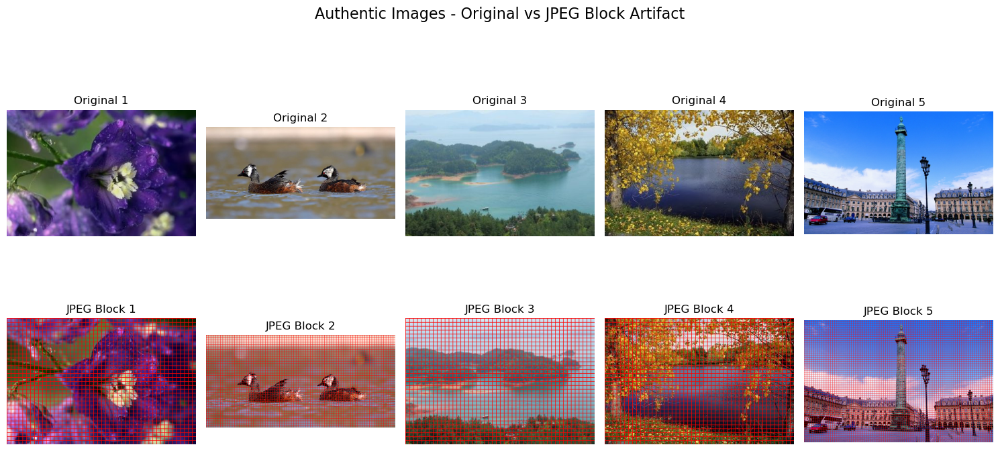

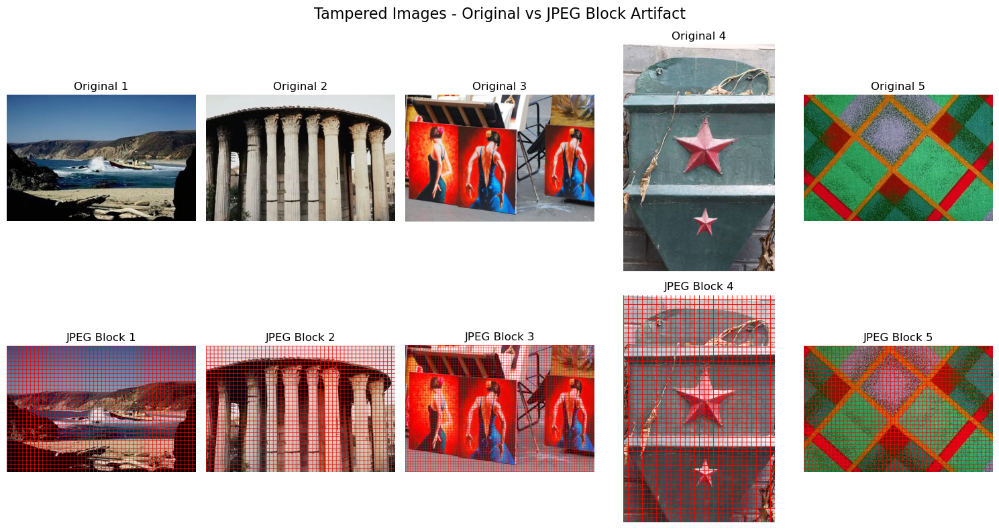

Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_174 (Conv2D)         (None, 62, 62, 32)        896       
                                                                 
 max_pooling2d_87 (MaxPoolin  (None, 31, 31, 32)       0         
 g2D)                                                            
                                                                 
 dropout_141 (Dropout)       (None, 31, 31, 32)        0         
                                                                 
 conv2d_175 (Conv2D)         (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_88 (MaxPoolin  (None, 14, 14, 64)       0         
 g2D)                                                            
                                                                 
 dropout_142 (Dropout)       (None, 14, 14, 64)      

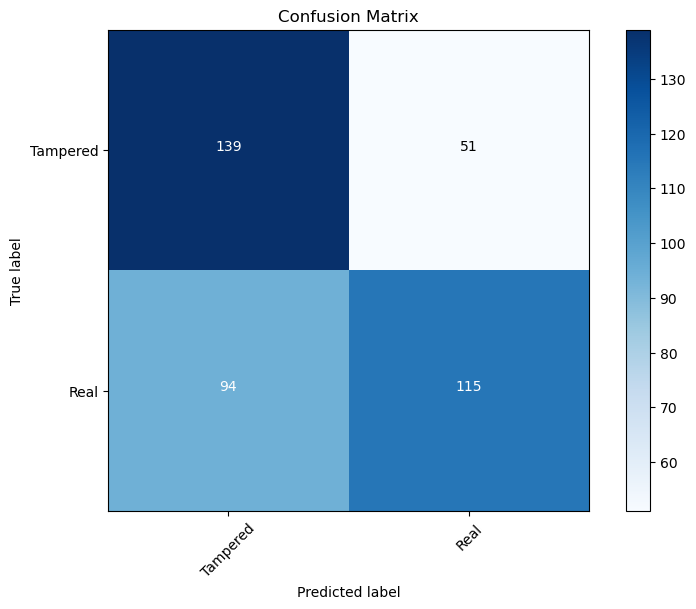

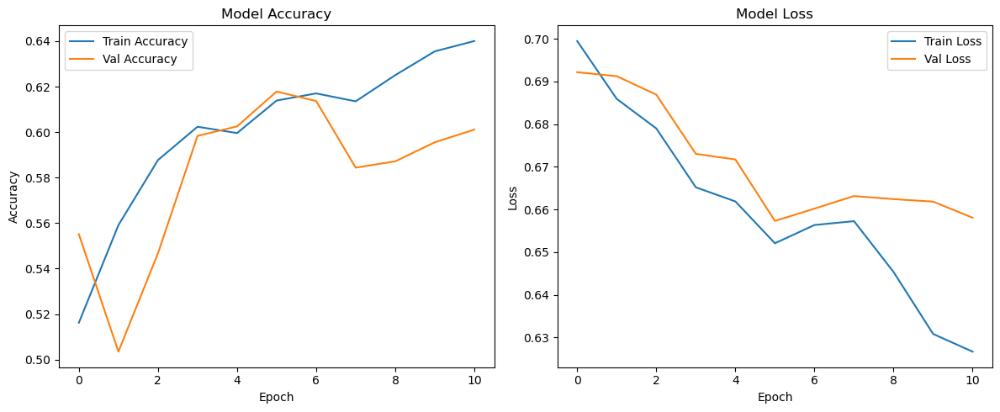


Sample predictions:
1/1 [==============================] - 0s 22ms/step
Image: Au_pla_30322.jpg
  Prediction: Real with 50.55% confidence
1/1 [==============================] - 0s 21ms/step
Image: Au_ani_10197.jpg
  Prediction: Tampered with 59.25% confidence
1/1 [==============================] - 0s 20ms/step
Image: Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg
  Prediction: Real with 50.97% confidence
1/1 [==============================] - 0s 21ms/step
Image: Tp_S_NND_S_N_arc00012_arc00012_01111.tif
  Prediction: Tampered with 50.38% confidence


In [36]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Dropout, Flatten, Dense
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

tf.keras.mixed_precision.set_global_policy('mixed_float16')

def convert_to_jpeg_block_artifact(path):
    image = Image.open(path).convert('RGB')
    img = image.copy()
    draw = ImageDraw.Draw(img)
    w, h = img.size
    for x in range(0, w, 8):
        draw.line([(x, 0), (x, h)], fill=(255, 0, 0), width=1)
    for y in range(0, h, 8):
        draw.line([(0, y), (w, y)], fill=(255, 0, 0), width=1)
    return img

def prepare_image_jpegblock(image_path, target_size=(64, 64)):
    return np.array(convert_to_jpeg_block_artifact(image_path).resize(target_size)) / 255.0

# Define paths
au_path = "/kaggle/input/casia-dataset/CASIA2/Au"  # Authentic images
tp_path = "/kaggle/input/casia-dataset/CASIA2/Tp"  # Tampered images

# Initialize lists
X = []  # Images
Y = []  # Labels (0=Tampered, 1=Authentic)

print("Loading authentic images...")
for img_name in os.listdir(au_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(au_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_jpegblock(img_path))
        Y.append(1)  # Label 1 = Authentic

print("Loading tampered images...")
for img_name in os.listdir(tp_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(tp_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_jpegblock(img_path))
        Y.append(0)  # Label 0 = Tampered

# Convert to numpy arrays
X = np.array(X)
Y = to_categorical(Y, 2)  # One-hot encoding

# Split into Train, Validation, Test
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)

print("\nData shapes:")
print("Train:", X_train.shape, Y_train.shape)
print("Val:", X_val.shape, Y_val.shape)
print("Test:", X_test.shape, Y_test.shape)

# Visualization function
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Show sample images
def display_samples(image_paths, title):
    plt.figure(figsize=(15, 8))
    plt.suptitle(title, fontsize=16)
    
    for i, img_path in enumerate(image_paths[:5]):
        # Original Image
        plt.subplot(2, 5, i+1)
        orig_img = Image.open(img_path)
        plt.imshow(orig_img)
        plt.title(f"Original {i+1}")
        plt.axis('off')
        
        # ELA Processed Image
        plt.subplot(2, 5, i+6)
        block_img = convert_to_jpeg_block_artifact(img_path)
        plt.imshow(block_img)
        plt.title(f"JPEG Block {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Authentic images
au_images = [os.path.join(au_path, f) for f in os.listdir(au_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(au_images, "Authentic Images - Original vs JPEG Block Artifact")

# Tampered images
tp_images = [os.path.join(tp_path, f) for f in os.listdir(tp_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(tp_images, "Tampered Images - Original vs JPEG Block Artifact")

# Simplified model architecture
def build_model(input_shape=(64, 64, 3)):
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(64, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(128, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Flatten(),
        Dense(256, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax', dtype='float32')  # Ensure output is float32
    ])
    return model

# Build model
model = build_model()
model.summary()

# Optimizer with learning rate schedule
optimizer = Adam(learning_rate=0.001)
model.compile(optimizer=optimizer, 
              loss='categorical_crossentropy', 
              metrics=['accuracy'])

# Callbacks
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

# Train model
print("\nTraining model...")
history = model.fit(
    X_train, Y_train,
    batch_size=64,  # Increased batch size for faster processing
    epochs=20,
    validation_data=(X_val, Y_val),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

# Save model
model.save('jpegblock_model.h5')
print("Model saved as 'jpegblock_model.h5'")

# Evaluate model
print("\nEvaluating model...")
test_loss, test_acc = model.evaluate(X_test, Y_test, verbose=0)
print(f"\nTest Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Predictions
Y_pred = model.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_true = np.argmax(Y_test, axis=1)

# Classification Report
print("\nClassification Report:")
print(classification_report(Y_true, Y_pred_classes, target_names=['Tampered', 'Real']))

# Confusion Matrix
confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
plt.figure(figsize=(8, 6))
plot_confusion_matrix(confusion_mtx, classes=['Tampered', 'Real'])
plt.title('Confusion Matrix')
plt.show()

# Plot training history
plt.figure(figsize=(12, 5))

# Accuracy plot
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()

# Loss plot
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()

plt.tight_layout()
plt.show()

# Sample predictions
def predict_image(model, image_path):
    image = prepare_image_jpegblock(image_path)
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)
    class_idx = np.argmax(prediction)
    confidence = np.max(prediction)
    return "Real" if class_idx == 1 else "Tampered", confidence

# Test on sample images
print("\nSample predictions:")
for img_path in au_images[:2] + tp_images[:2]:
    prediction, confidence = predict_image(model, img_path)
    print(f"Image: {os.path.basename(img_path)}")
    print(f"  Prediction: {prediction} with {confidence*100:.2f}% confidence")

Loading authentic images...
Loading tampered images...

Data shapes:
Train: (2867, 64, 64, 3) (2867, 2)
Val: (717, 64, 64, 3) (717, 2)
Test: (399, 64, 64, 3) (399, 2)


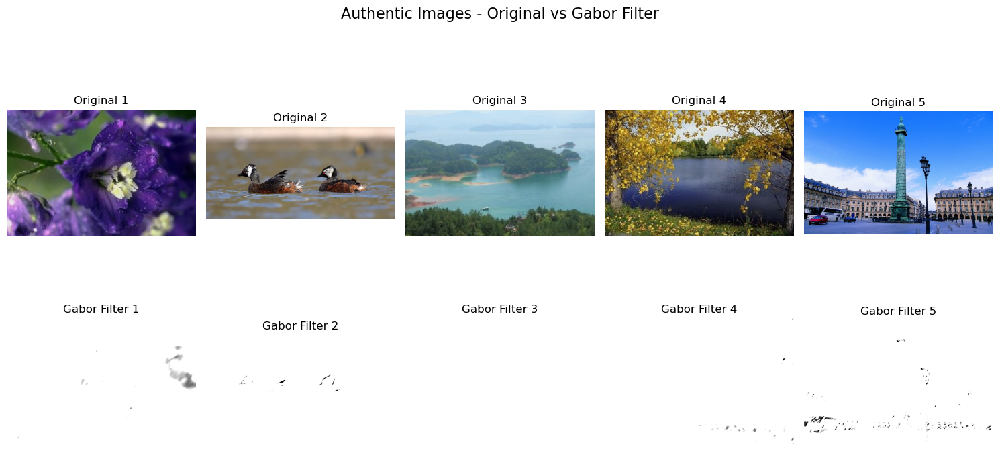

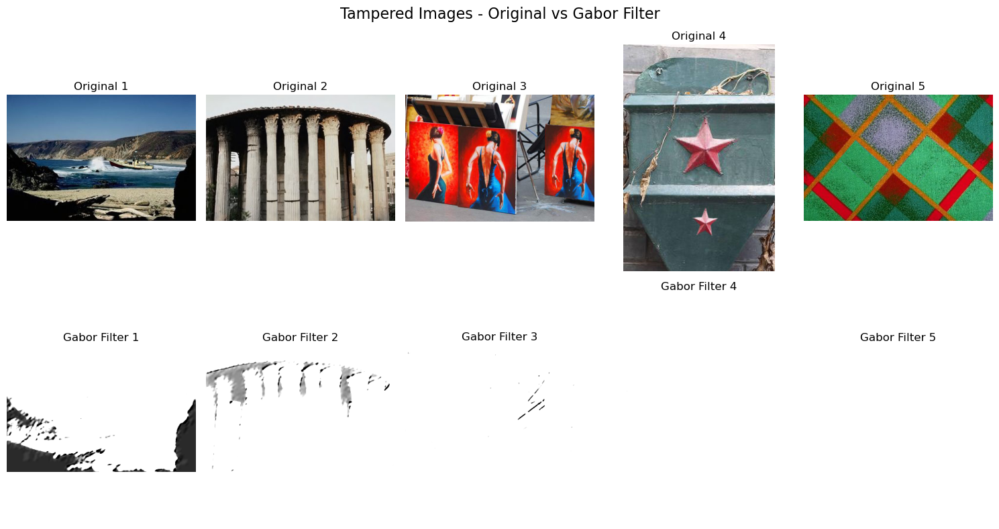

Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_177 (Conv2D)         (None, 62, 62, 32)        896       
                                                                 
 max_pooling2d_90 (MaxPoolin  (None, 31, 31, 32)       0         
 g2D)                                                            
                                                                 
 dropout_145 (Dropout)       (None, 31, 31, 32)        0         
                                                                 
 conv2d_178 (Conv2D)         (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_91 (MaxPoolin  (None, 14, 14, 64)       0         
 g2D)                                                            
                                                                 
 dropout_146 (Dropout)       (None, 14, 14, 64)      

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


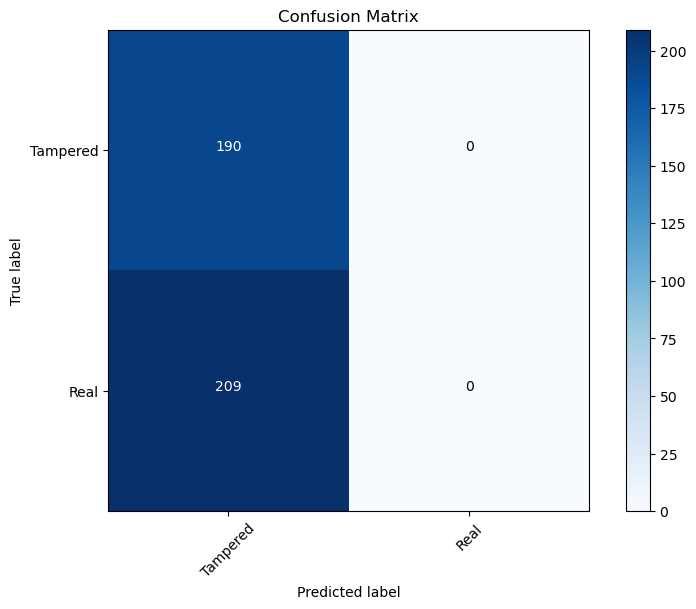

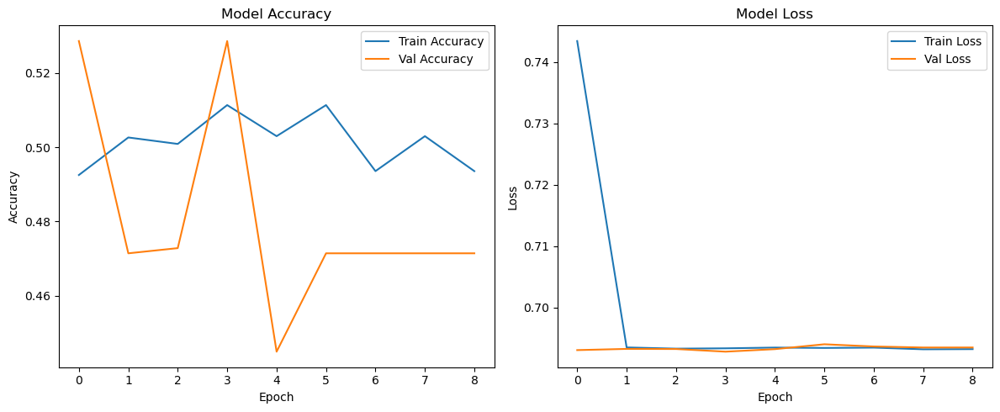


Sample predictions:
1/1 [==============================] - 0s 22ms/step
Image: Au_pla_30322.jpg
  Prediction: Tampered with 50.34% confidence
1/1 [==============================] - 0s 21ms/step
Image: Au_ani_10197.jpg
  Prediction: Tampered with 50.36% confidence
1/1 [==============================] - 0s 21ms/step
Image: Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg
  Prediction: Tampered with 50.36% confidence
1/1 [==============================] - 0s 20ms/step
Image: Tp_S_NND_S_N_arc00012_arc00012_01111.tif
  Prediction: Tampered with 50.38% confidence


In [37]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import cv2
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Dropout, Flatten, Dense
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

tf.keras.mixed_precision.set_global_policy('mixed_float16')

def convert_to_gabor(path):
    image = Image.open(path).convert('L')
    arr = np.array(image)
    kernel = cv2.getGaborKernel((9, 9), 4.0, np.pi/4, 10.0, 0.5, 0, ktype=cv2.CV_32F)
    filtered = cv2.filter2D(arr, cv2.CV_8UC3, kernel)
    filtered_rgb = np.stack([filtered]*3, axis=-1)
    return Image.fromarray(filtered_rgb)

def prepare_image_gabor(image_path, target_size=(64, 64)):
    return np.array(convert_to_gabor(image_path).resize(target_size)) / 255.0

# Define paths
au_path = "/kaggle/input/casia-dataset/CASIA2/Au"  # Authentic images
tp_path = "/kaggle/input/casia-dataset/CASIA2/Tp"  # Tampered images

# Initialize lists
X = []  # Images
Y = []  # Labels (0=Tampered, 1=Authentic)

print("Loading authentic images...")
for img_name in os.listdir(au_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(au_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_gabor(img_path))
        Y.append(1)  # Label 1 = Authentic

print("Loading tampered images...")
for img_name in os.listdir(tp_path)[:2000]:  # Limit to 2000 for faster processing
    img_path = os.path.join(tp_path, img_name)
    if img_path.lower().endswith(('.jpg', '.png', '.tif')):
        X.append(prepare_image_gabor(img_path))
        Y.append(0)  # Label 0 = Tampered

# Convert to numpy arrays
X = np.array(X)
Y = to_categorical(Y, 2)  # One-hot encoding

# Split into Train, Validation, Test
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.2, random_state=42)

print("\nData shapes:")
print("Train:", X_train.shape, Y_train.shape)
print("Val:", X_val.shape, Y_val.shape)
print("Test:", X_test.shape, Y_test.shape)

# Visualization function
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Show sample images
def display_samples(image_paths, title):
    plt.figure(figsize=(15, 8))
    plt.suptitle(title, fontsize=16)
    
    for i, img_path in enumerate(image_paths[:5]):
        # Original Image
        plt.subplot(2, 5, i+1)
        orig_img = Image.open(img_path)
        plt.imshow(orig_img)
        plt.title(f"Original {i+1}")
        plt.axis('off')
        
        # Gabor Filter Processed Image
        plt.subplot(2, 5, i+6)
        gabor_img = convert_to_gabor(img_path)
        plt.imshow(gabor_img)
        plt.title(f"Gabor Filter {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Authentic images
au_images = [os.path.join(au_path, f) for f in os.listdir(au_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(au_images, "Authentic Images - Original vs Gabor Filter")

# Tampered images
tp_images = [os.path.join(tp_path, f) for f in os.listdir(tp_path) 
             if f.lower().endswith(('.jpg', '.png', '.tif'))][:5]
display_samples(tp_images, "Tampered Images - Original vs Gabor Filter")

# Simplified model architecture
def build_model(input_shape=(64, 64, 3)):
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(64, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Conv2D(128, (3, 3), activation='relu'),
        MaxPool2D(pool_size=(2, 2)),
        Dropout(0.25),
        
        Flatten(),
        Dense(256, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax', dtype='float32')  # Ensure output is float32
    ])
    return model

# Build model
model = build_model()
model.summary()

# Optimizer with learning rate schedule
optimizer = Adam(learning_rate=0.001)
model.compile(optimizer=optimizer, 
              loss='categorical_crossentropy', 
              metrics=['accuracy'])

# Callbacks
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

# Train model
print("\nTraining model...")
history = model.fit(
    X_train, Y_train,
    batch_size=64,  # Increased batch size for faster processing
    epochs=20,
    validation_data=(X_val, Y_val),
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

# Save model
model.save('gabor_filter_model.h5')
print("Model saved as 'gabor_filter_model.h5'")

# Evaluate model
print("\nEvaluating model...")
test_loss, test_acc = model.evaluate(X_test, Y_test, verbose=0)
print(f"\nTest Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Predictions
Y_pred = model.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_true = np.argmax(Y_test, axis=1)

# Classification Report
print("\nClassification Report:")
print(classification_report(Y_true, Y_pred_classes, target_names=['Tampered', 'Real']))

# Confusion Matrix
confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
plt.figure(figsize=(8, 6))
plot_confusion_matrix(confusion_mtx, classes=['Tampered', 'Real'])
plt.title('Confusion Matrix')
plt.show()

# Plot training history
plt.figure(figsize=(12, 5))

# Accuracy plot
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()

# Loss plot
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()

plt.tight_layout()
plt.show()

# Sample predictions
def predict_image(model, image_path):
    image = prepare_image_gabor(image_path)
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)
    class_idx = np.argmax(prediction)
    confidence = np.max(prediction)
    return "Real" if class_idx == 1 else "Tampered", confidence

# Test on sample images
print("\nSample predictions:")
for img_path in au_images[:2] + tp_images[:2]:
    prediction, confidence = predict_image(model, img_path)
    print(f"Image: {os.path.basename(img_path)}")
    print(f"  Prediction: {prediction} with {confidence*100:.2f}% confidence")